### Adaptive Thresholding


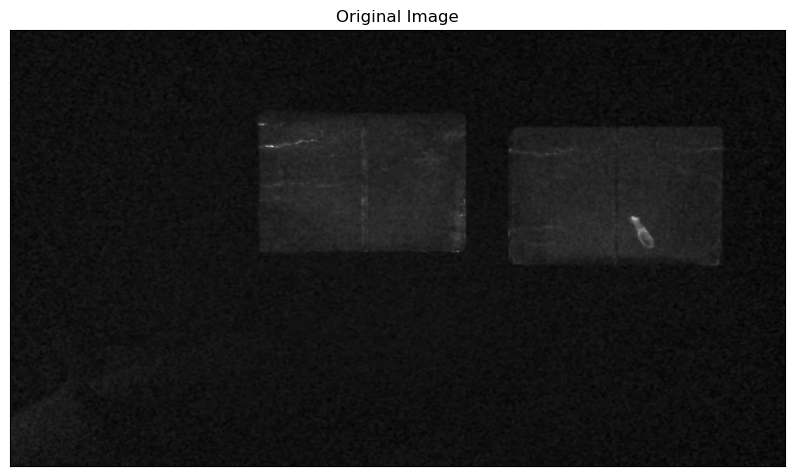

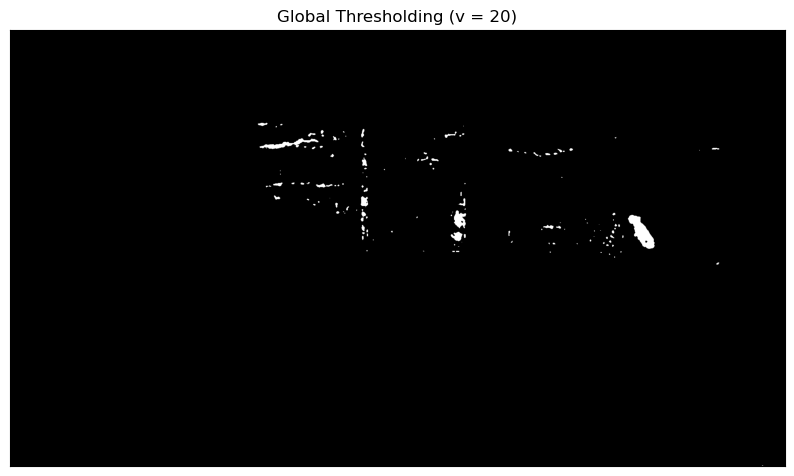

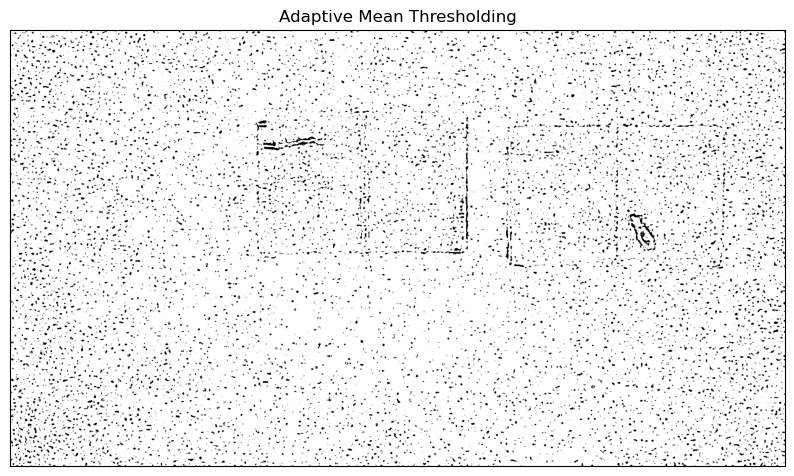

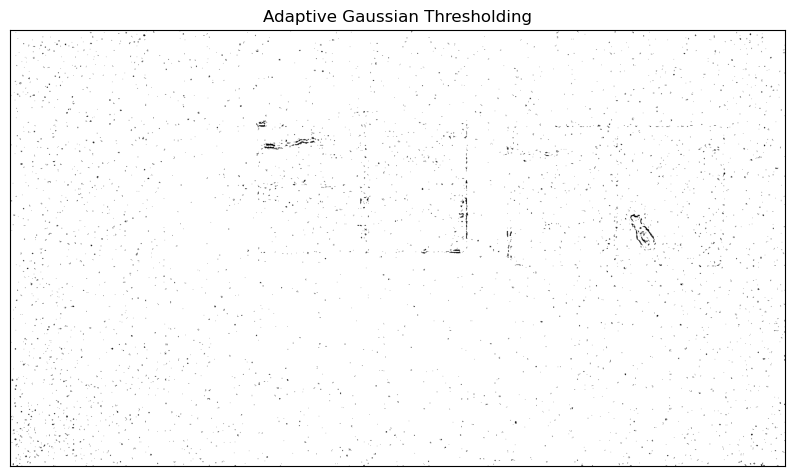

In [14]:
import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt
img = cv.imread('Images/Img4.jpg', cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"
img = cv.medianBlur(img,5)
thresh = 20
ret,th1 = cv.threshold(img,thresh,255,cv.THRESH_BINARY)
th2 = cv.adaptiveThreshold(img,255,cv.ADAPTIVE_THRESH_MEAN_C,\
            cv.THRESH_BINARY,11,2)
th3 = cv.adaptiveThreshold(img,255,cv.ADAPTIVE_THRESH_GAUSSIAN_C,\
            cv.THRESH_BINARY,11,2)
titles = ['Original Image', f'Global Thresholding (v = {thresh})',
            'Adaptive Mean Thresholding', 'Adaptive Gaussian Thresholding']
images = [img, th1, th2, th3]
for i in range(4):
    #plt.subplot(2,2,i+1),
    plt.subplots(figsize=(10, 10))
    plt.imshow(images[i],'gray')
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([])
plt.show()

#### Python Code implementation for Region based segmentation:

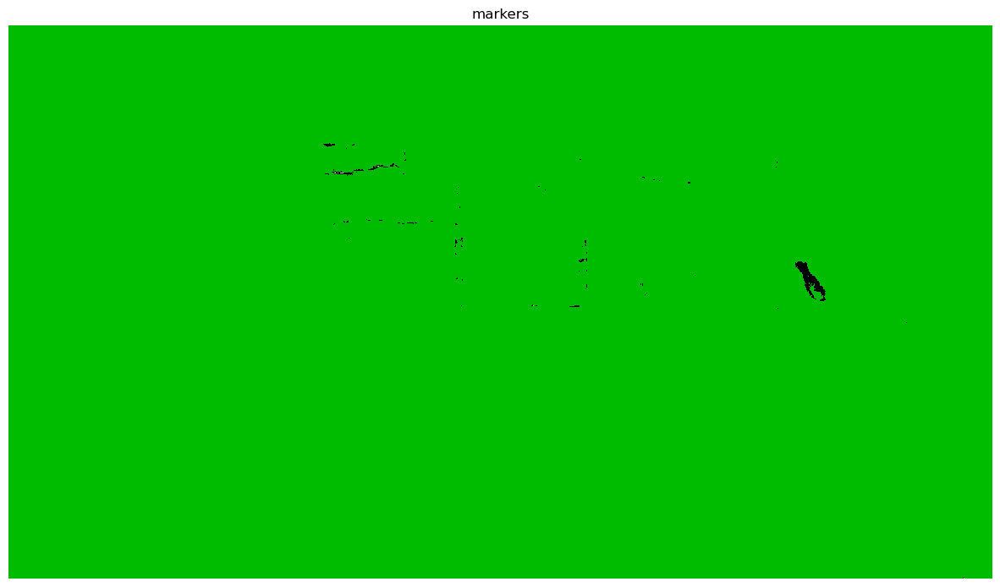

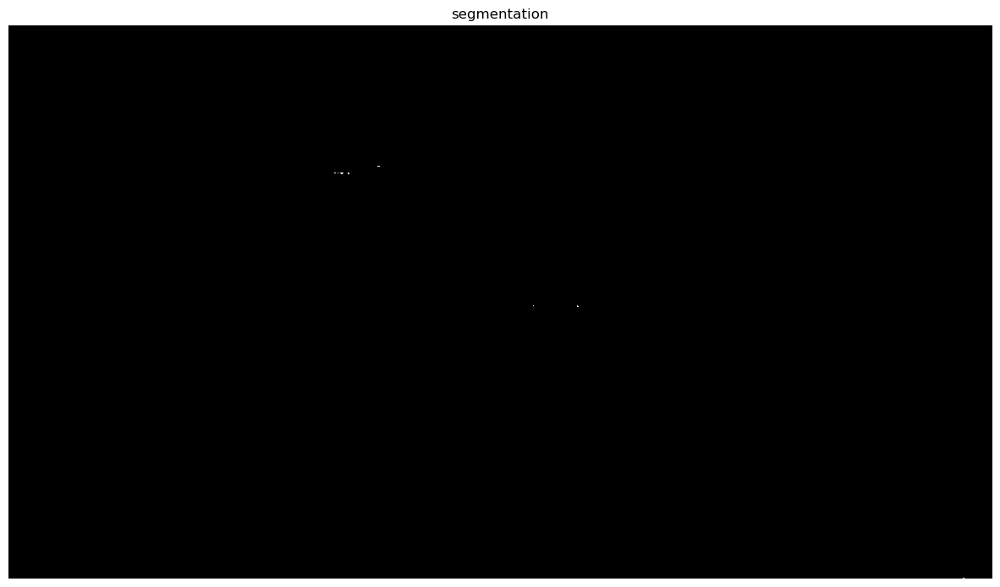

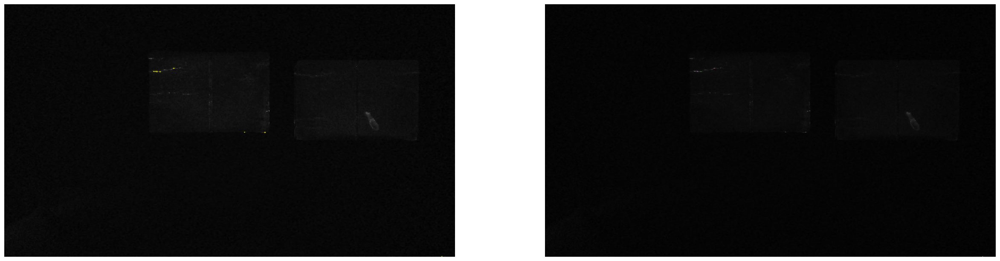

In [15]:
from skimage.filters import sobel
from skimage.segmentation import watershed
import cv2 
from scipy import ndimage as ndi
from skimage.color import label2rgb

img = cv2.imread('Images/Img4.jpg')
grey = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
elevation_map = sobel(grey)

# fig, ax = plt.subplots(figsize=(8, 8))

# ax.imshow(elevation_map, cmap=plt.cm.gray, interpolation='nearest')

# ax.axis('off')

# ax.set_title('elevation_map')

markers = np.zeros_like(grey)

markers[grey < 30] = 1

markers[grey > 150] = 2

fig, ax = plt.subplots(figsize=(15, 15))

ax.imshow(markers, cmap=plt.cm.nipy_spectral, interpolation='nearest')

ax.axis('off')

ax.set_title('markers')

segmentation = watershed(elevation_map, markers)

fig, ax = plt.subplots(figsize=(15, 15))

ax.imshow(segmentation, cmap=plt.cm.gray, interpolation='nearest')

ax.axis('off')

ax.set_title('segmentation')

segmentation = ndi.binary_fill_holes(segmentation - 1)

labeled_coins, _ = ndi.label(segmentation)

image_label_overlay = label2rgb(labeled_coins, image=grey)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(30, 30), sharex=True, sharey=True)

ax1.imshow(grey, cmap=plt.cm.gray, interpolation='nearest')

ax1.contour(segmentation, [0.5], linewidths=1, colors='y')

ax1.axis('off')

#ax1.set_adjustable('box-forced')

ax2.imshow(image_label_overlay, interpolation='nearest')

ax2.axis('off')

#ax2.set_adjustable('box-forced')

fig.subplots_adjust(bottom=0.1, top=0.9)
#fig.subplots_adjust(**margin)

### Adaptive Method + Morphological Operations

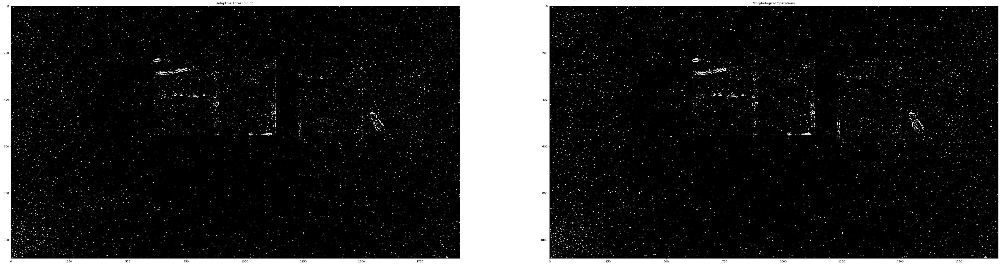

In [16]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the image in grayscale
image = cv2.imread('Images/Img4.jpg', cv2.IMREAD_GRAYSCALE)

# Preprocess the image
# Apply Gaussian blur to reduce noise
blurred = cv2.GaussianBlur(image, (5, 5), 0)

# Apply adaptive thresholding
adaptive_thresh = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                        cv2.THRESH_BINARY_INV, 11, 2)

# Morphological operations to clean up the thresholded image
kernel = np.ones((3, 3), np.uint8)
morph = cv2.morphologyEx(adaptive_thresh, cv2.MORPH_CLOSE, kernel)

# Display the results
plt.figure(figsize=(100,100))
#plt.subplot(131), plt.imshow(image, cmap='gray'), plt.title('Original Image')
plt.subplot(132), plt.imshow(adaptive_thresh, cmap='gray'), plt.title('Adaptive Thresholding')
plt.subplot(133), plt.imshow(morph, cmap='gray'), plt.title('Morphological Operations')
plt.show()




### Enhanced Code with Edge Detection:

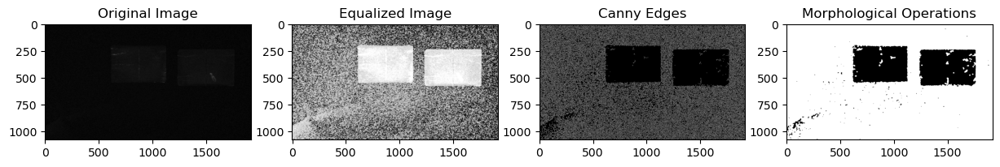

In [17]:
# Load the image in grayscale
image = cv2.imread('Images/Img4.jpg', cv2.IMREAD_GRAYSCALE)

# Preprocess the image
# Apply Gaussian blur to reduce noise
blurred = cv2.GaussianBlur(image, (5, 5), 0)

# Apply histogram equalization for contrast enhancement
equalized = cv2.equalizeHist(blurred)

# Apply Canny edge detection
edges = cv2.Canny(equalized, 50, 150)

# Apply adaptive thresholding
adaptive_thresh = cv2.adaptiveThreshold(edges, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                        cv2.THRESH_BINARY_INV, 11, 2)

# Morphological operations to clean up the thresholded image
kernel = np.ones((3, 3), np.uint8)
morph = cv2.morphologyEx(adaptive_thresh, cv2.MORPH_CLOSE, kernel)

# Display the results
plt.figure(figsize=(15, 10))
plt.subplot(141), plt.imshow(image, cmap='gray'), plt.title('Original Image')
plt.subplot(142), plt.imshow(equalized, cmap='gray'), plt.title('Equalized Image')
plt.subplot(143), plt.imshow(edges, cmap='gray'), plt.title('Canny Edges')
plt.subplot(144), plt.imshow(morph, cmap='gray'), plt.title('Morphological Operations')
plt.show()


### Python Code implementation for Robert operator for image segmentation:

Text(0.5, 1.0, 'Output Image')

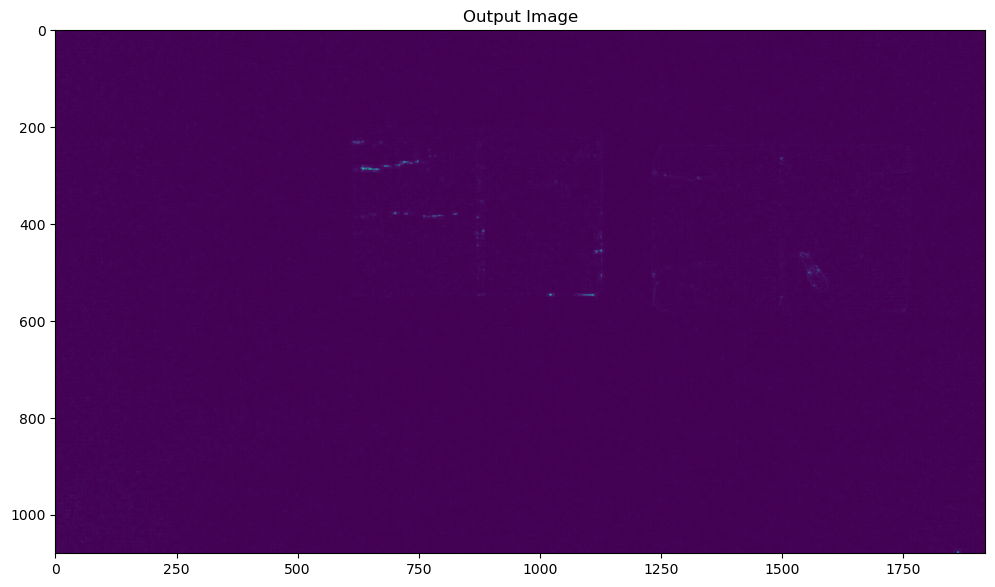

In [18]:
import cv2  
import numpy as np 
from scipy import ndimage 
  
roberts_cross_v = np.array( [[1, 0 ], 
                             [0,-1 ]] ) 
  
roberts_cross_h = np.array( [[ 0, 1 ], 
                             [ -1, 0 ]] ) 

# input_img = cv2.imread('test_image1.bmp')
# img = cv2.cvtColor(input_img, cv2.COLOR_BGR2GRAY)
# print(img)
img = cv2.imread("Images/Img4.jpg",0).astype('float64') 
img/=255.0
# print(img)
vertical = ndimage.convolve( img, roberts_cross_v ) 
horizontal = ndimage.convolve( img, roberts_cross_h ) 
  
edged_img = np.sqrt( np.square(horizontal) + np.square(vertical)) 
edged_img*=255
#cv2.imwrite("output.jpg",edged_img)
plt.subplots(figsize=(12, 12))
plt.imshow(edged_img)
plt.title('Output Image')

Text(0.5, 1.0, 'Output Image')

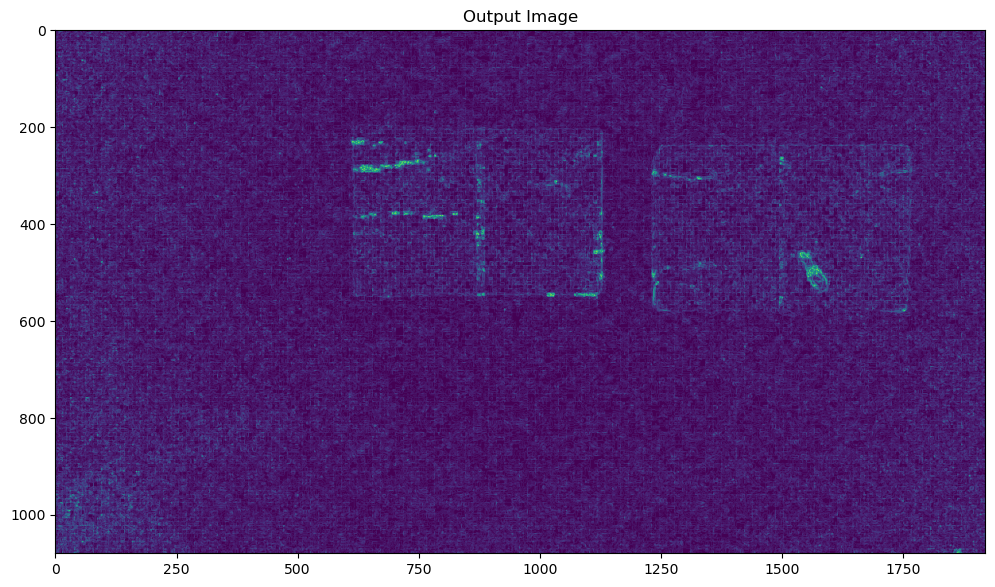

In [34]:
input_img = cv2.imread('Images/Img4.jpg')
img = cv2.cvtColor(input_img, cv2.COLOR_BGR2GRAY)
# print(img)
# img = cv2.imread("test_image1.bmp",0).astype('float64') 
# img/=255.0
#print(img)
roberts_cross_v = np.array( [[1, 0 ], 
                             [0,-1 ]] ) 
  
roberts_cross_h = np.array( [[ 0, 1 ], 
                             [ -1, 0 ]] ) 

vertical = ndimage.convolve( img, roberts_cross_v ) 
horizontal = ndimage.convolve( img, roberts_cross_h ) 
  
edged_img = np.sqrt( np.square(horizontal) + np.square(vertical)) 
#edged_img*=255
#cv2.imwrite("output.jpg",edged_img)
plt.subplots(figsize=(12, 12))
plt.imshow(edged_img)
plt.title('Output Image')

### Prewitts Operation

Text(0.5, 1.0, 'Prewitt')

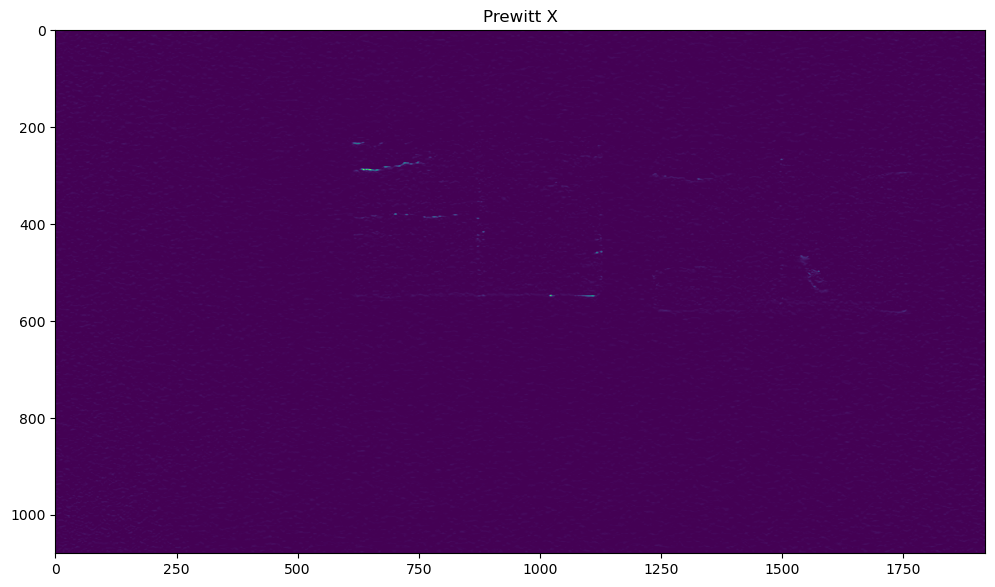

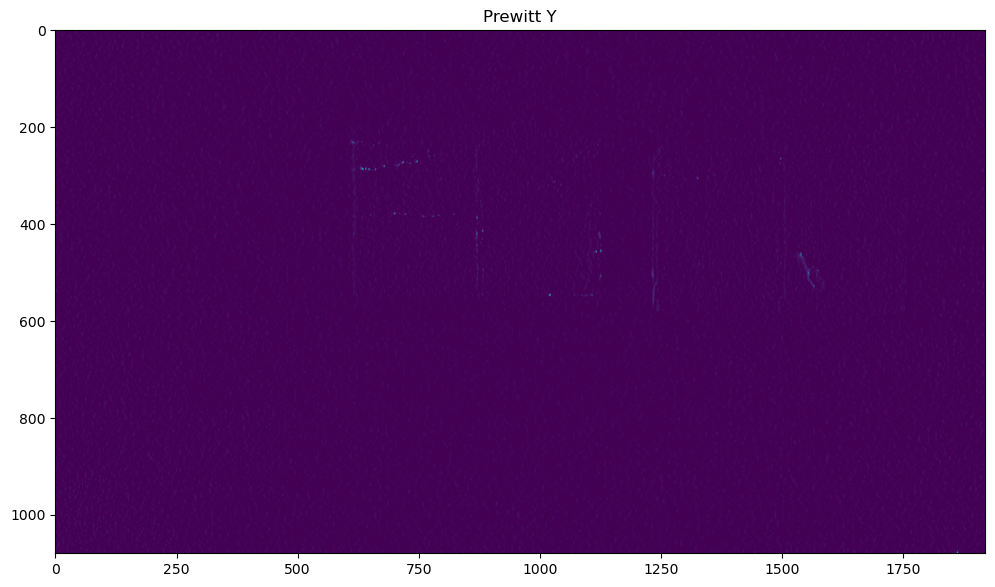

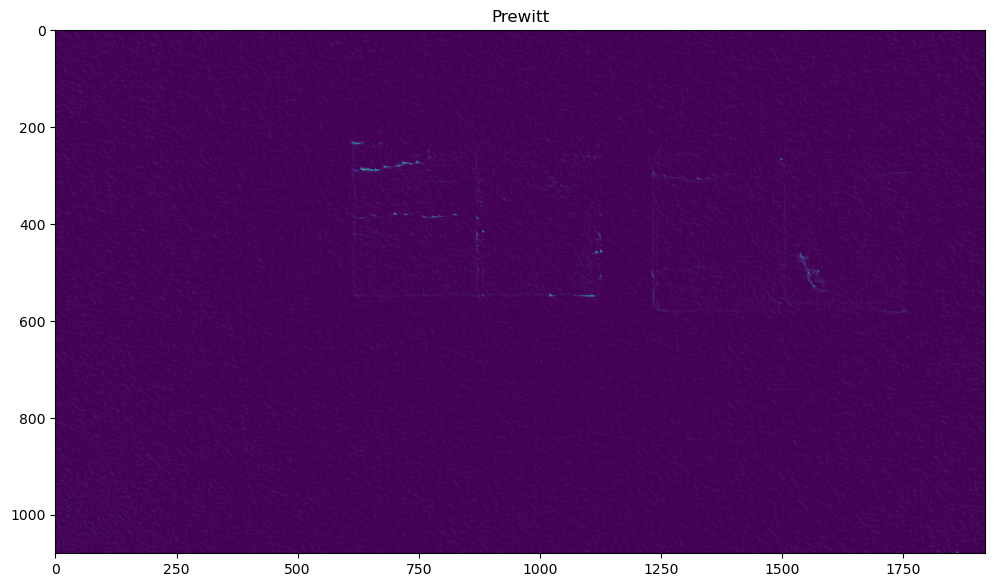

In [19]:
img = cv2.imread('Images/Img4.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_gaussian = cv2.GaussianBlur(gray,(3,3),0)

#prewitt
kernelx = np.array([[1,1,1],[0,0,0],[-1,-1,-1]])
kernely = np.array([[-1,0,1],[-1,0,1],[-1,0,1]])

img_prewittx = cv2.filter2D(img_gaussian, -1, kernelx)
img_prewitty = cv2.filter2D(img_gaussian, -1, kernely)

# cv2.imshow("Prewitt X", img_prewittx)
# cv2.imshow("Prewitt Y", img_prewitty)
# cv2.imshow("Prewitt", img_prewittx + img_prewitty)

plt.subplots(figsize=(12, 12))
plt.imshow(img_prewittx)
plt.title('Prewitt X')

plt.subplots(figsize=(12, 12))
plt.imshow(img_prewitty)
plt.title('Prewitt Y')

plt.subplots(figsize=(12, 12))
plt.imshow(img_prewittx + img_prewitty)
plt.title('Prewitt')

Text(0.5, 1.0, 'Morphological Operations')

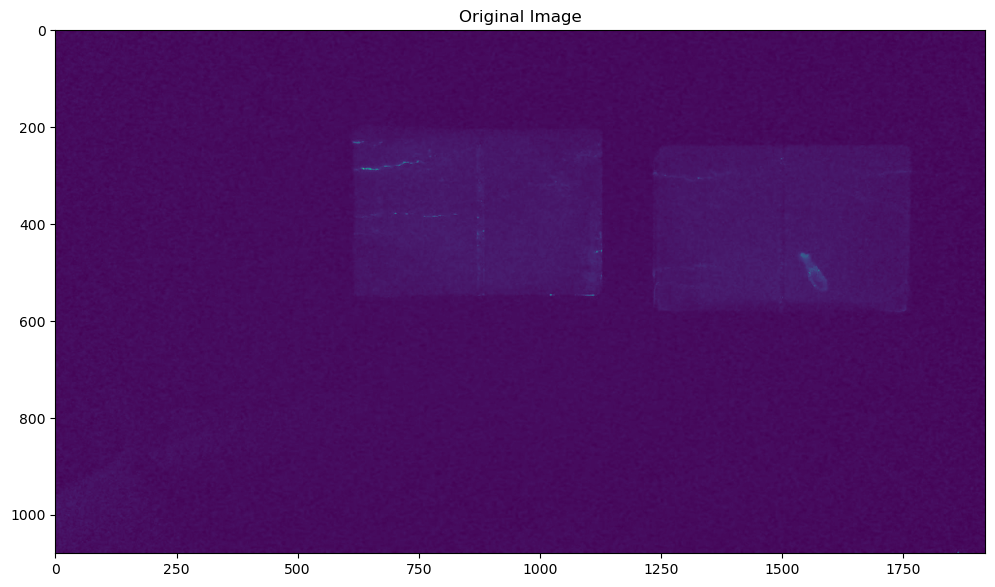

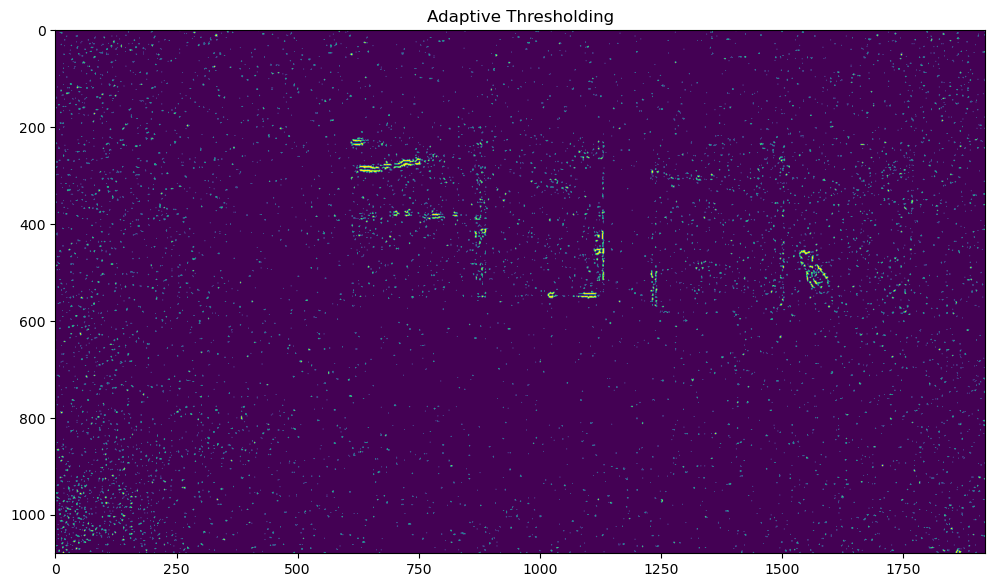

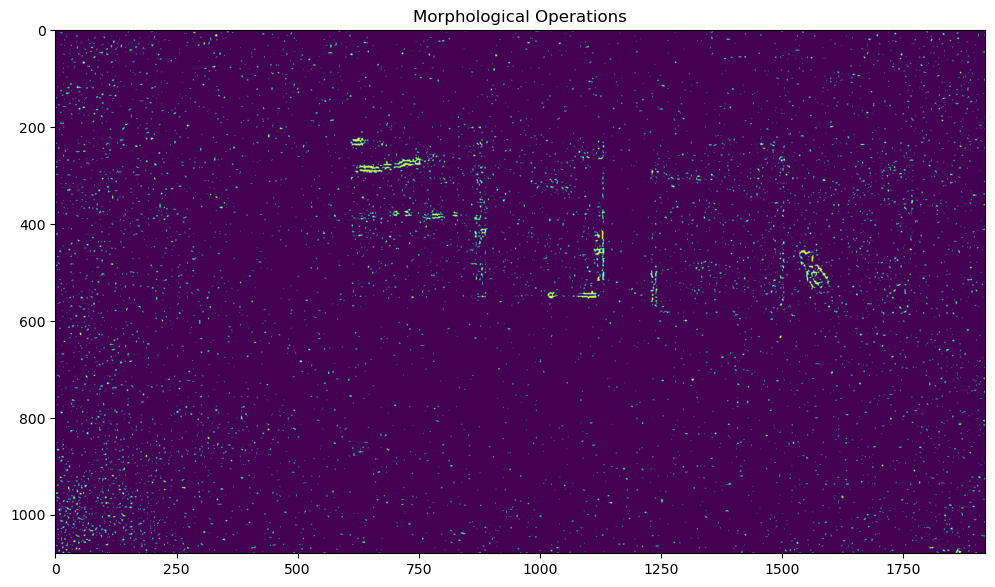

In [20]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the image in grayscale
image = cv2.imread('Images/Img4.jpg', cv2.IMREAD_GRAYSCALE)

# Preprocess the image
# Apply Gaussian blur to reduce noise
blurred = cv2.GaussianBlur(image, (5, 5), 0)

# Apply adaptive thresholding
adaptive_thresh = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                        cv2.THRESH_BINARY_INV, 11, 2)

# Morphological operations to clean up the thresholded image
kernel = np.ones((3, 3), np.uint8)
morph = cv2.morphologyEx(adaptive_thresh, cv2.MORPH_CLOSE, kernel)

# Display the results
# plt.figure(figsize=(100,100))
# #plt.subplot(131), plt.imshow(image, cmap='gray'), plt.title('Original Image')
# plt.subplot(132), plt.imshow(adaptive_thresh, cmap='gray'), plt.title('Adaptive Thresholding')
# plt.subplot(133), plt.imshow(morph, cmap='gray'), plt.title('Morphological Operations')
# plt.show()

plt.subplots(figsize=(12, 12))
plt.imshow(image)
plt.title('Original Image')

plt.subplots(figsize=(12, 12))
plt.imshow(adaptive_thresh)
plt.title('Adaptive Thresholding')

plt.subplots(figsize=(12, 12))
plt.imshow(morph)
plt.title('Morphological Operations')


Text(0.5, 1.0, 'Thresholded and Morphological Operations')

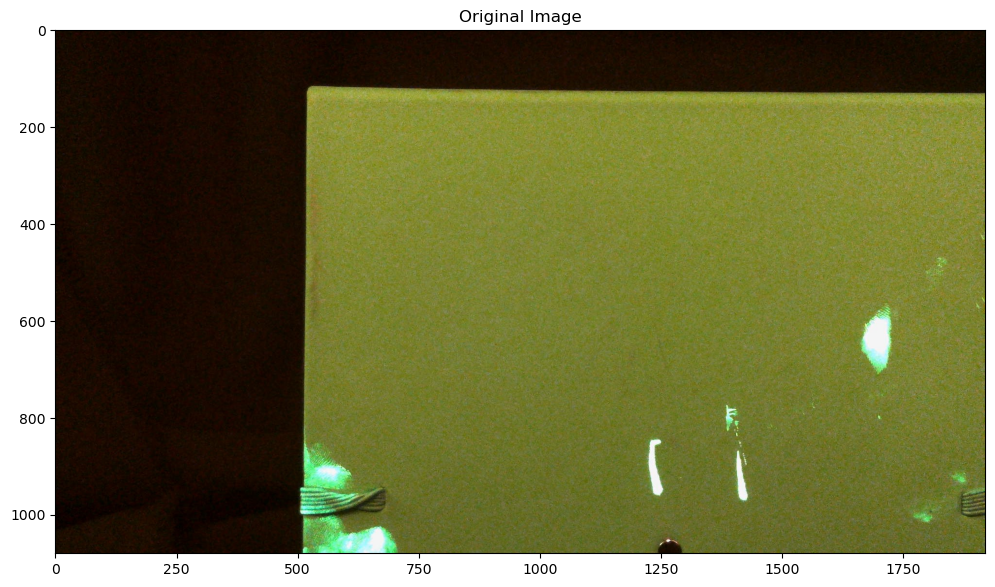

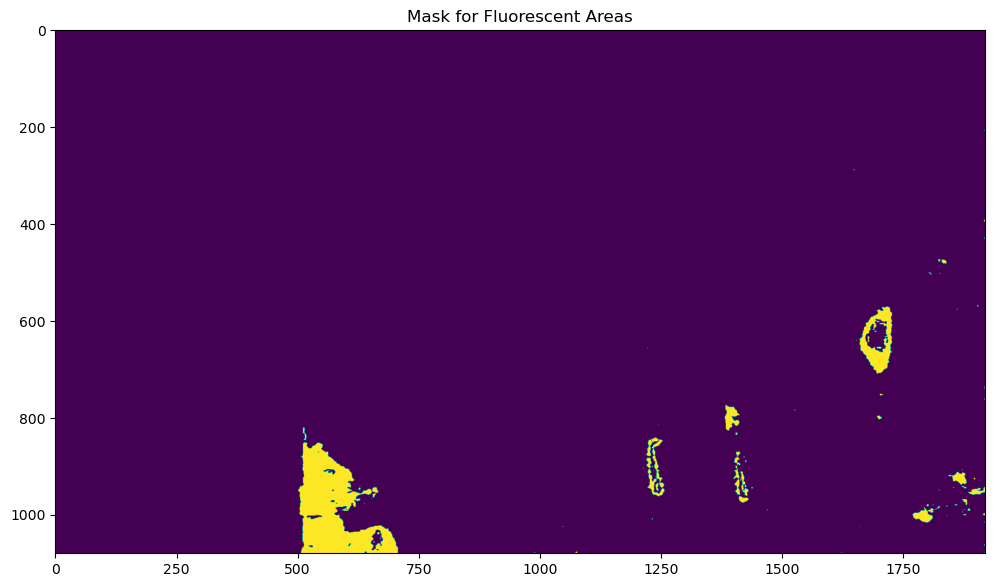

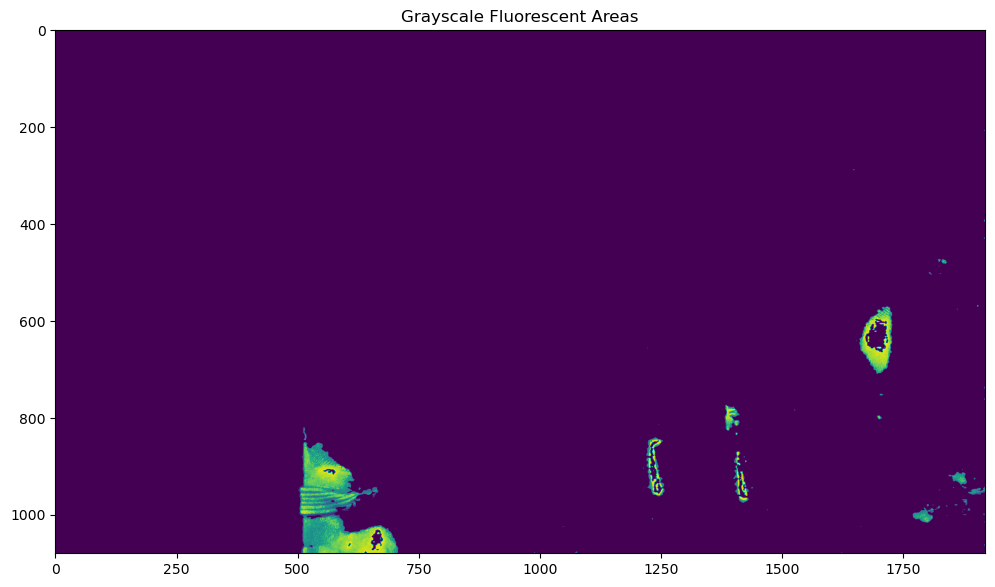

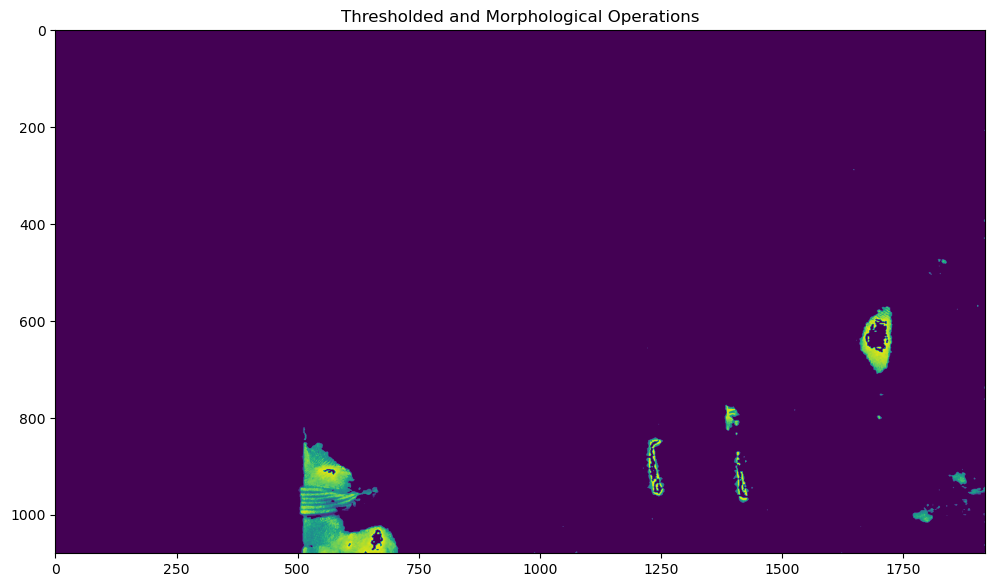

In [77]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the image
image = cv2.imread('Images/Img5.jpg')

# Convert the image to HSV color space
hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

#hMin = 70 , sMin = 170, vMin = 110), (hMax = 179 , sMax = 255, vMax = 255 - worked for Img2
#(hMin = 39 , sMin = 0, vMin = 29), (hMax = 111 , sMax = 252, vMax = 255)
#(hMin = 42 , sMin = 0, vMin = 29), (hMax = 111 , sMax = 252, vMax = 255)
# Get current positions of all trackbars
h_min = 42 #cv2.getTrackbarPos('HMin', 'Trackbars')
s_min = 0 #cv2.getTrackbarPos('SMin', 'Trackbars')
v_min = 29 #cv2.getTrackbarPos('VMin', 'Trackbars')
h_max = 111 #cv2.getTrackbarPos('HMax', 'Trackbars')
s_max = 255#cv2.getTrackbarPos('SMax', 'Trackbars')
v_max = 255 #cv2.getTrackbarPos('VMax', 'Trackbars')

# Set the HSV range for the mask
lower_bound = np.array([h_min, s_min, v_min])
upper_bound = np.array([h_max, s_max, v_max])

# # Define the range for the fluorescent color (adjust as needed)
# lower_bound = np.array([30, 100, 100])
# upper_bound = np.array([90, 255, 255])

# Create a mask for the fluorescent color
mask = cv2.inRange(hsv_image, lower_bound, upper_bound)

# Apply the mask to get the fluorescent areas
fluorescent_areas = cv2.bitwise_and(image, image, mask=mask)

# Convert the result to grayscale
gray_fluorescent = cv2.cvtColor(fluorescent_areas, cv2.COLOR_BGR2GRAY)

# Apply Gaussian blur to reduce noise
blurred = cv2.GaussianBlur(gray_fluorescent, (5, 5), 0)

# Apply thresholding to isolate bright areas
_, thresholded = cv2.threshold(blurred, 50, 255, cv2.THRESH_BINARY)

# Morphological operations to clean up the thresholded image
kernel = np.ones((5, 5), np.uint8)
morph = cv2.morphologyEx(thresholded, cv2.MORPH_CLOSE, kernel)

# Display the results
# plt.figure(figsize=(15, 10))
# plt.subplot(141), plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)), plt.title('Original Image')
# plt.subplot(142), plt.imshow(mask, cmap='gray'), plt.title('Mask for Fluorescent Areas')
# plt.subplot(143), plt.imshow(gray_fluorescent, cmap='gray'), plt.title('Grayscale Fluorescent Areas')
# plt.subplot(144), plt.imshow(morph, cmap='gray'), plt.title('Thresholded and Morphological Operations')
# plt.show()


plt.subplots(figsize=(12, 12))
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Original Image')

plt.subplots(figsize=(12, 12))
plt.imshow(mask)
plt.title('Mask for Fluorescent Areas')

plt.subplots(figsize=(12, 12))
plt.imshow(gray_fluorescent)
plt.title('Grayscale Fluorescent Areas')

plt.subplots(figsize=(12, 12))
plt.imshow(gray_fluorescent)
plt.title('Thresholded and Morphological Operations')



Code to pick HSV values

In [21]:
import cv2
import numpy as np

# def nothing(x):
#     pass

# # Load image
# image = cv2.imread('Images/Img5.jpg')

# # Create a window
# cv2.namedWindow('image')

# # Create trackbars for color change
# # Hue is from 0-179 for Opencv
# cv2.createTrackbar('HMin', 'image', 0, 179, nothing)
# cv2.createTrackbar('SMin', 'image', 0, 255, nothing)
# cv2.createTrackbar('VMin', 'image', 0, 255, nothing)
# cv2.createTrackbar('HMax', 'image', 0, 179, nothing)
# cv2.createTrackbar('SMax', 'image', 0, 255, nothing)
# cv2.createTrackbar('VMax', 'image', 0, 255, nothing)

# # Set default value for Max HSV trackbars
# cv2.setTrackbarPos('HMax', 'image', 179)
# cv2.setTrackbarPos('SMax', 'image', 255)
# cv2.setTrackbarPos('VMax', 'image', 255)

# # Initialize HSV min/max values
# hMin = sMin = vMin = hMax = sMax = vMax = 0
# phMin = psMin = pvMin = phMax = psMax = pvMax = 0

# while(1):
#     # Get current positions of all trackbars
#     hMin = cv2.getTrackbarPos('HMin', 'image')
#     sMin = cv2.getTrackbarPos('SMin', 'image')
#     vMin = cv2.getTrackbarPos('VMin', 'image')
#     hMax = cv2.getTrackbarPos('HMax', 'image')
#     sMax = cv2.getTrackbarPos('SMax', 'image')
#     vMax = cv2.getTrackbarPos('VMax', 'image')

#     # Set minimum and maximum HSV values to display
#     lower = np.array([hMin, sMin, vMin])
#     upper = np.array([hMax, sMax, vMax])

#     # Convert to HSV format and color threshold
#     hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
#     mask = cv2.inRange(hsv, lower, upper)
#     result = cv2.bitwise_and(image, image, mask=mask)

#     # Print if there is a change in HSV value
#     if((phMin != hMin) | (psMin != sMin) | (pvMin != vMin) | (phMax != hMax) | (psMax != sMax) | (pvMax != vMax) ):
#         print("(hMin = %d , sMin = %d, vMin = %d), (hMax = %d , sMax = %d, vMax = %d)" % (hMin , sMin , vMin, hMax, sMax , vMax))
#         phMin = hMin
#         psMin = sMin
#         pvMin = vMin
#         phMax = hMax
#         psMax = sMax
#         pvMax = vMax

#     # Display result image
#     cv2.imshow('image', result)
#     if cv2.waitKey(10) & 0xFF == ord('q'):
#         break

# cv2.destroyAllWindows() 

(hMin = 0 , sMin = 0, vMin = 0), (hMax = 179 , sMax = 255, vMax = 255)


KeyboardInterrupt: 

: 

Other ways

NameError: name 'mask' is not defined

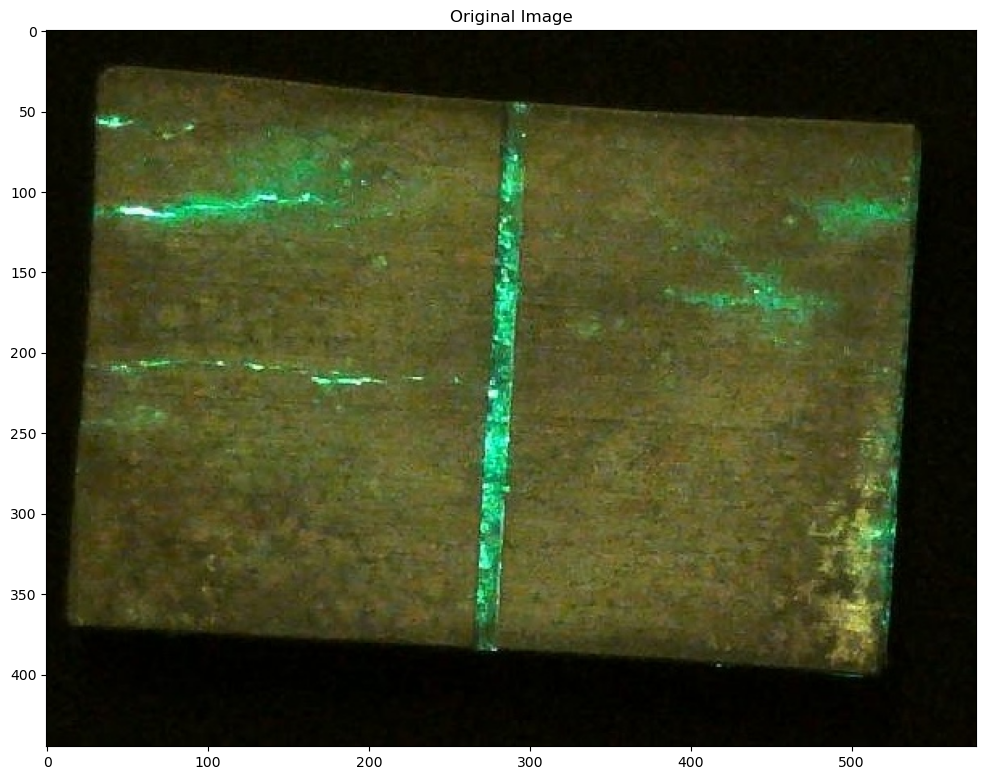

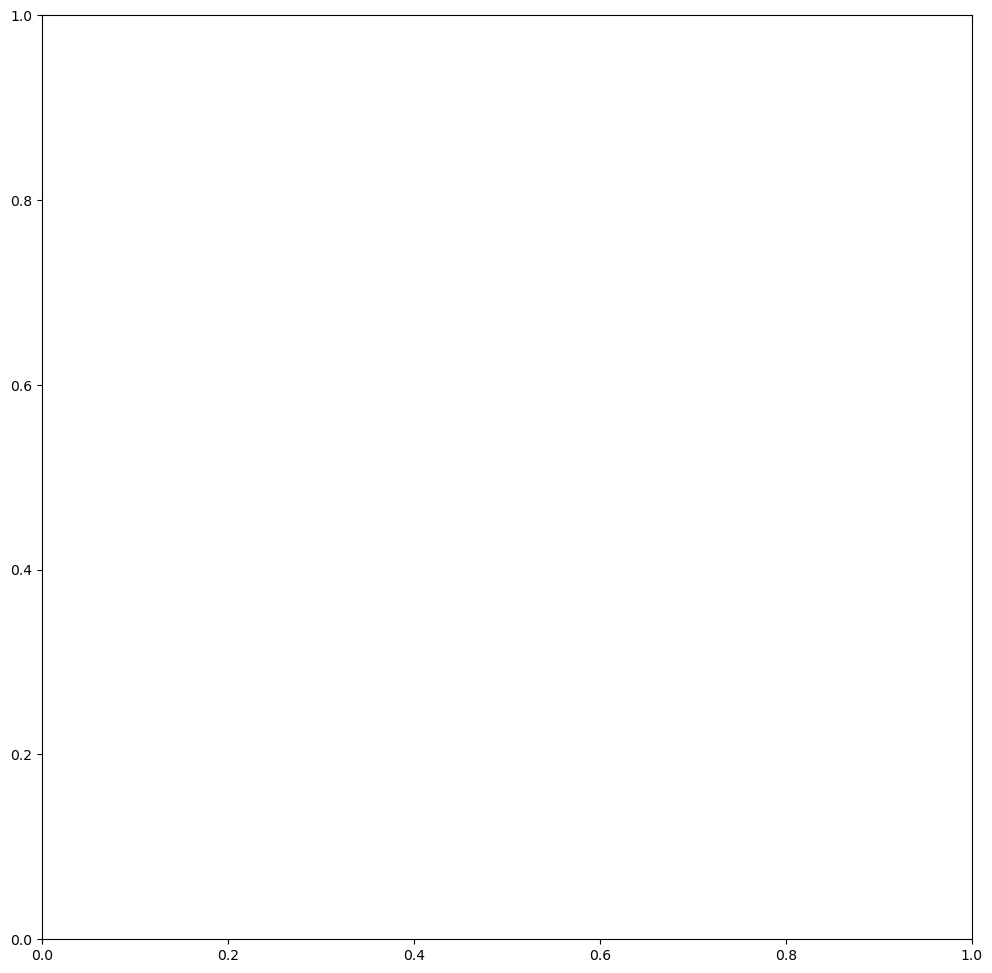

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def roberts_cross(image):
    """Apply the Roberts Cross operator to an image."""
    kernel_x = np.array([[1, 0], [0, -1]], dtype=int)
    kernel_y = np.array([[0, 1], [-1, 0]], dtype=int)
    
    img_x = cv2.filter2D(image, cv2.CV_64F, kernel_x)
    img_y = cv2.filter2D(image, cv2.CV_64F, kernel_y)
    
    return np.sqrt(img_x ** 2 + img_y ** 2)

# Load the image
image = cv2.imread('Images/Img2.jpg')

# Convert the image to grayscale
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Apply Gaussian blur to reduce noise
blurred = cv2.GaussianBlur(gray_image, (3, 3), 0)

# Apply Roberts Cross operator
edges = roberts_cross(blurred)

# Normalize the result to the range 0 to 255
edges = cv2.normalize(edges, None, 0, 255, cv2.NORM_MINMAX)

# Convert edges to 8-bit unsigned integer
edges = edges.astype(np.uint8)

# Apply thresholding to isolate bright areas
_, thresholded = cv2.threshold(edges, 20, 80, cv2.THRESH_BINARY)

# Morphological operations to clean up the thresholded image
kernel = np.ones((3, 3), np.uint8)
morph = cv2.morphologyEx(thresholded, cv2.MORPH_CLOSE, kernel)

plt.subplots(figsize=(12, 12))
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Original Image')

plt.subplots(figsize=(12, 12))
plt.imshow(mask)
plt.title('Grayscale Image')

plt.subplots(figsize=(12, 12))
plt.imshow(edges)
plt.title('Roberts Cross Edges')

plt.subplots(figsize=(12, 12))
plt.imshow(morph)
plt.title('Thresholded and Morphological Operations')



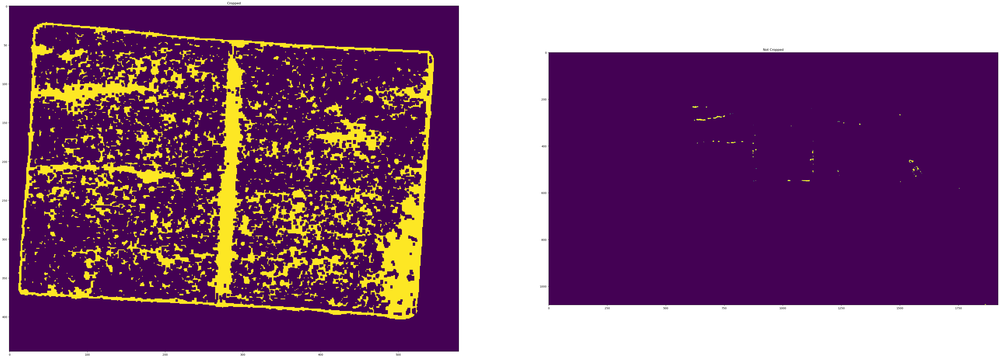

In [71]:
# Load the image
image = cv2.imread('Images/Img4.jpg')

# Convert the image to grayscale
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Apply Gaussian blur to reduce noise
blurred = cv2.GaussianBlur(gray_image, (3, 3), 0)

# Apply Roberts Cross operator
edges = roberts_cross(blurred)

# Normalize the result to the range 0 to 255
edges = cv2.normalize(edges, None, 0, 255, cv2.NORM_MINMAX)

# Convert edges to 8-bit unsigned integer
edges = edges.astype(np.uint8)

# Apply thresholding to isolate bright areas
_, thresholded = cv2.threshold(edges, 20, 80, cv2.THRESH_BINARY)

# Morphological operations to clean up the thresholded image
kernel = np.ones((3, 3), np.uint8)
morph2 = cv2.morphologyEx(thresholded, cv2.MORPH_CLOSE, kernel)

# plt.subplots(figsize=(12, 12))
# plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
# plt.title('Original Image')

# plt.subplots(figsize=(12, 12))
# plt.imshow(mask)
# plt.title('Grayscale Image')

# plt.subplots(figsize=(12, 12))
# plt.imshow(morph)
# plt.title('Roberts Cross Edges')

# plt.subplots(figsize=(12, 12))
# plt.imshow(morph2)
# plt.title('Thresholded and Morphological Operations')

# Display the results
plt.figure(figsize=(100,100))
#plt.subplot(131), plt.imshow(image, cmap='gray'), plt.title('Original Image')
plt.subplot(132), plt.imshow(morph), plt.title('Cropped')
plt.subplot(133), plt.imshow(morph2), plt.title('Not Cropped')
plt.show()

Contrast Limited Adaptive Histogram Equalization (CLAHE) to equalize images. CLAHE is a variant of Adaptive histogram equalization (AHE) which takes care of over-amplification of the contrast. CLAHE operates on small regions in the image, called tiles, rather than the entire image. The neighboring tiles are then combined using bilinear interpolation to remove the artificial boundaries. 


Explanation:
* Contrast Enhancement:
    CLAHE is used to enhance the contrast of the image, making cracks more visible.
* Grayscale Conversion:
    The image is converted to grayscale to simplify processing.
* Gaussian Blur:
    Gaussian blur is applied to reduce noise, which helps in edge detection.
* Canny Edge Detection:
    The Canny edge detection algorithm is used to detect edges in the image.
* Thresholding:
    Thresholding isolates the bright areas corresponding to the edges.
* Morphological Operations:
    Morphological operations clean up the thresholded image, better isolating the cracks.


Text(0.5, 1.0, 'Thresholded and Morphological Operations')

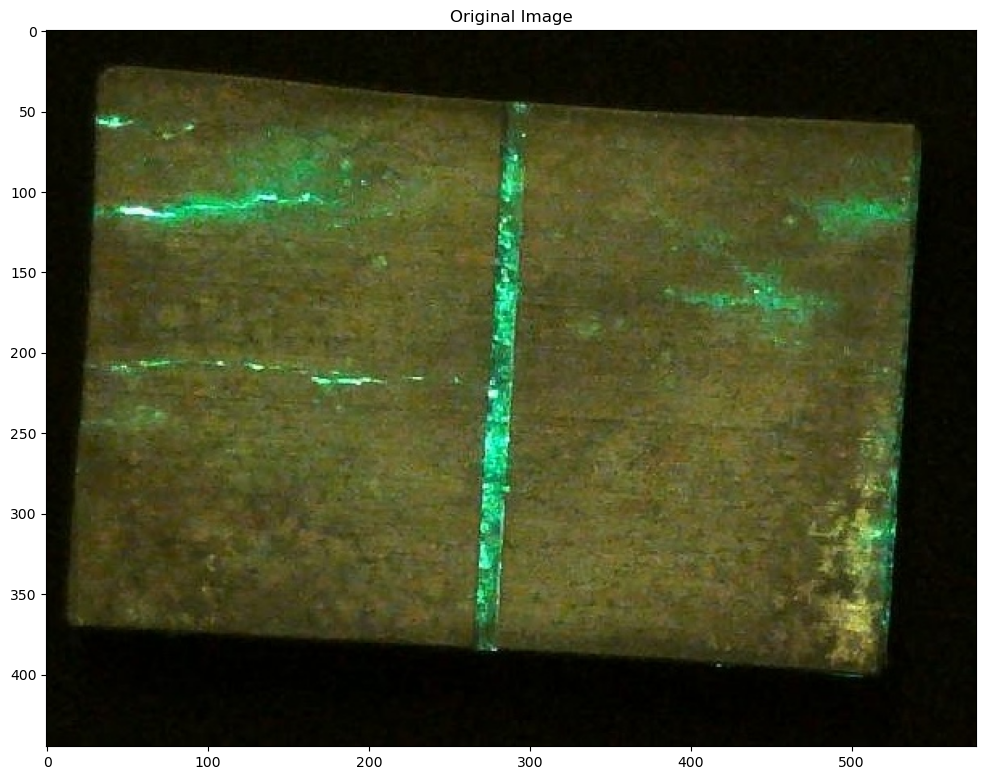

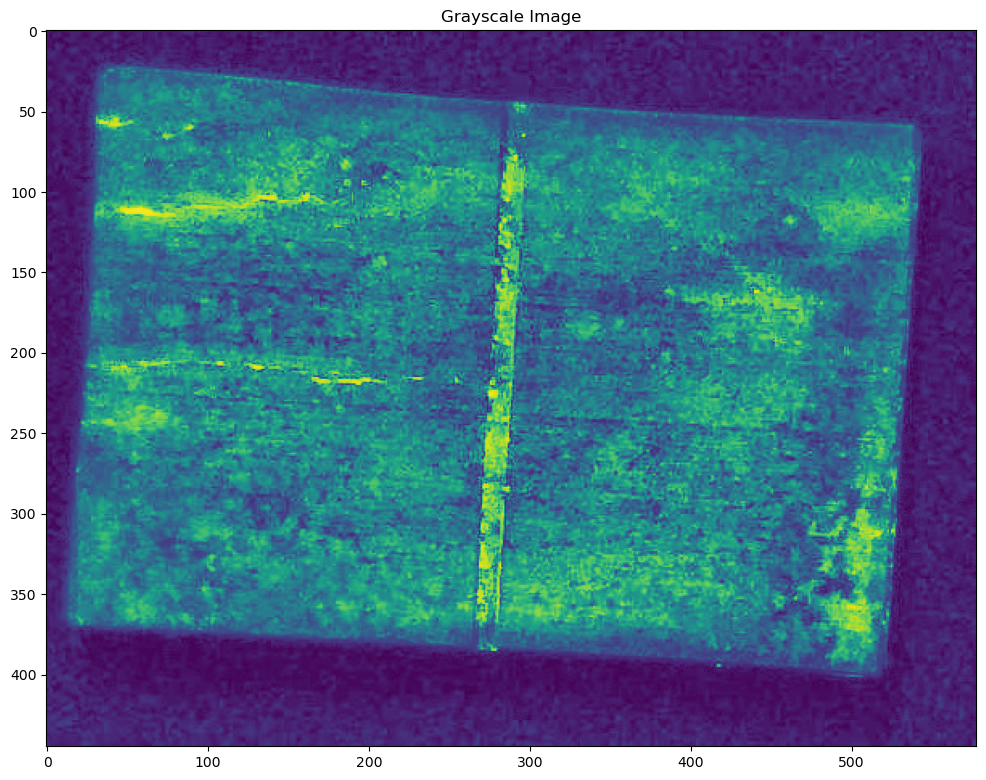

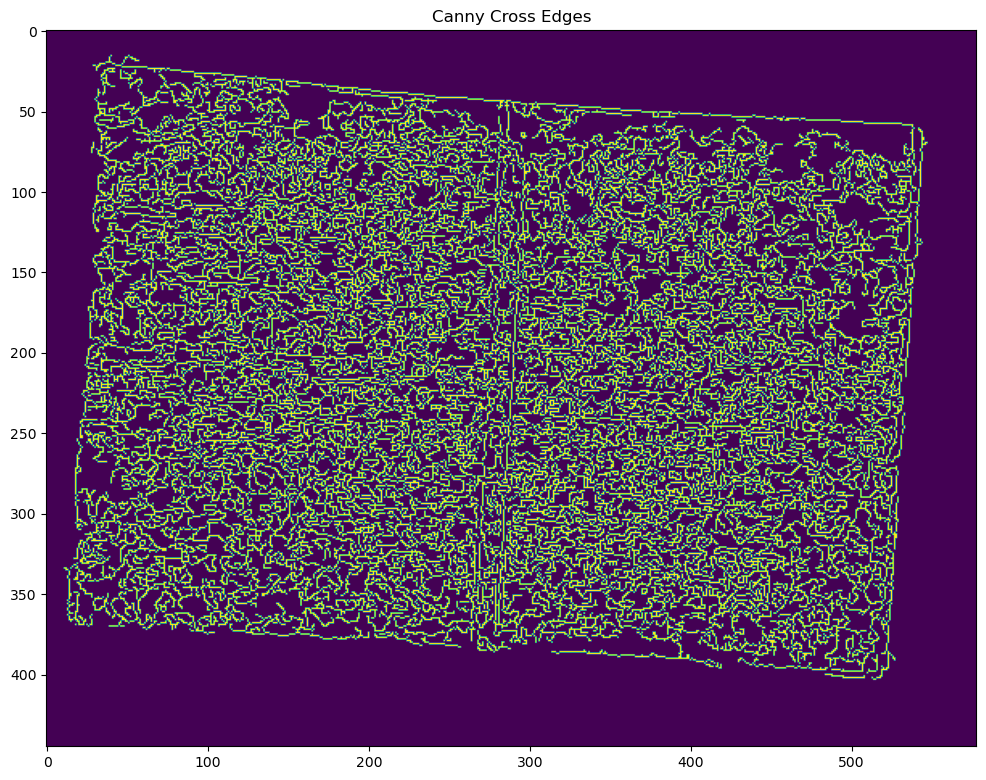

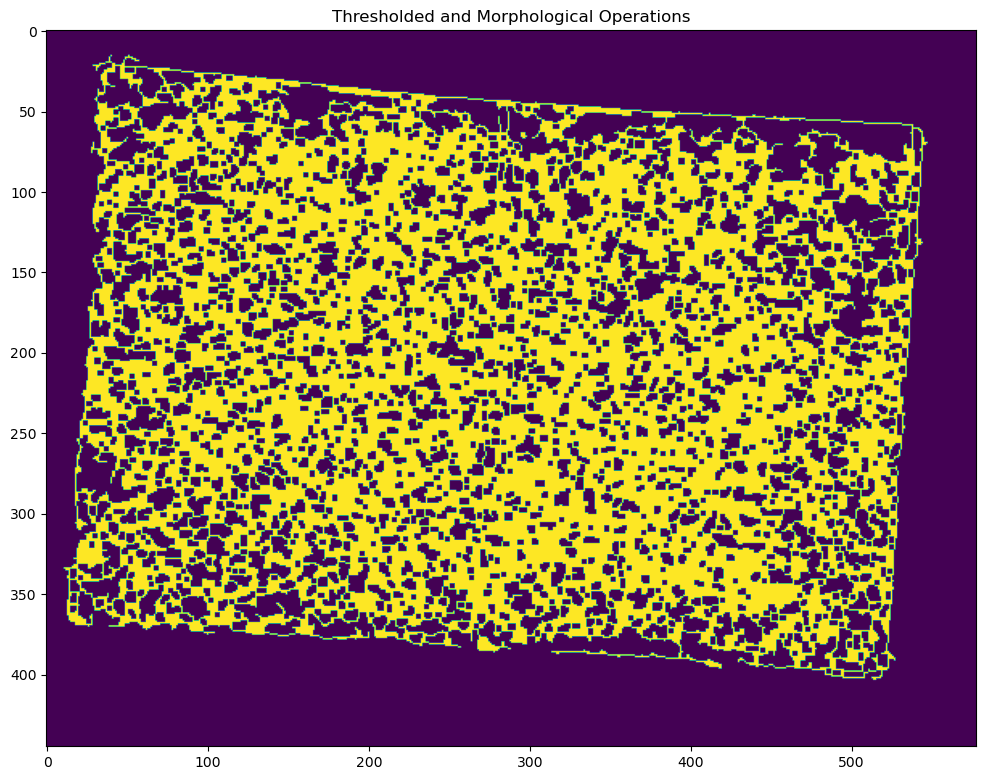

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the image
image = cv2.imread('Images/Img2.jpg')

# Enhance the contrast using CLAHE (Contrast Limited Adaptive Histogram Equalization)
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8, 8))
enhanced_image = clahe.apply(gray_image)

# Apply Gaussian blur to reduce noise
blurred = cv2.GaussianBlur(enhanced_image, (3, 3), 0)

# Apply Canny edge detection
edges = cv2.Canny(blurred, 50, 150)

# Apply thresholding to isolate bright areas
_, thresholded = cv2.threshold(edges, 50, 255, cv2.THRESH_BINARY)

# Morphological operations to clean up the thresholded image
kernel = np.ones((3, 3), np.uint8)
morph = cv2.morphologyEx(thresholded, cv2.MORPH_CLOSE, kernel)

plt.subplots(figsize=(12, 12))
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Original Image')

plt.subplots(figsize=(12, 12))
plt.imshow(enhanced_image)
plt.title('Grayscale Image')

plt.subplots(figsize=(12, 12))
plt.imshow(edges)
plt.title('Canny Cross Edges')

plt.subplots(figsize=(12, 12))
plt.imshow(morph)
plt.title('Thresholded and Morphological Operations')


Historgram of RGB Image

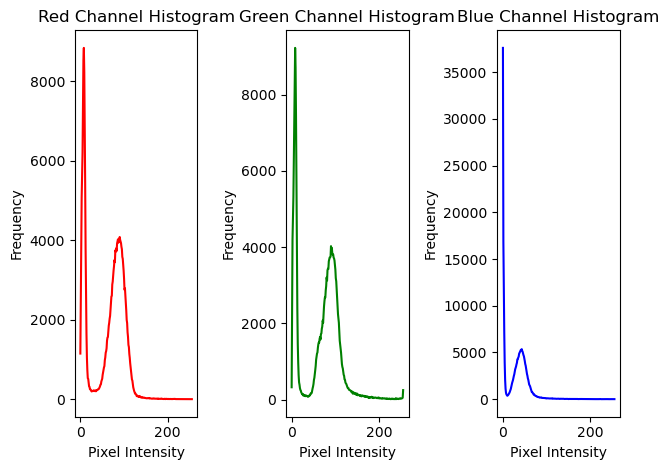

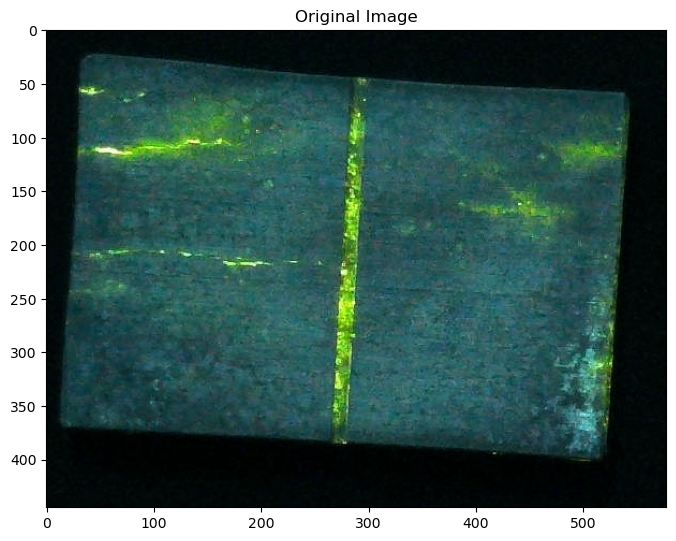

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the image
image = cv2.imread('Images/Img2.jpg')

# Split the image into its respective channels
b, g, r = cv2.split(image)

# Calculate the histograms for each channel
hist_b = cv2.calcHist([b], [0], None, [256], [0, 256])
hist_g = cv2.calcHist([g], [0], None, [256], [0, 256])
hist_r = cv2.calcHist([r], [0], None, [256], [0, 256])


# Plot the histograms


plt.subplot(131)
plt.plot(hist_r, color='red')
plt.title('Red Channel Histogram')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')

plt.subplot(132)
plt.plot(hist_g, color='green')
plt.title('Green Channel Histogram')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')

plt.subplot(133)
plt.plot(hist_b, color='blue')
plt.title('Blue Channel Histogram')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

plt.subplots(figsize=(8, 8))
plt.imshow(image)
plt.title('Original Image')
plt.show()


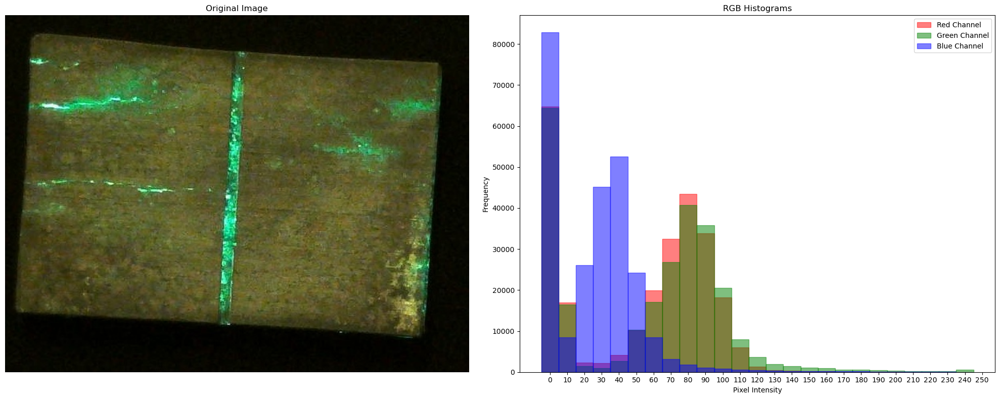

In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the image
image = cv2.imread('Images/Img2.jpg')

# Split the image into its respective channels
b, g, r = cv2.split(image)

# Calculate the histograms for each channel with bins of size 10
bins = np.arange(0, 257, 10)  # Create bins from 0 to 256 with a step size of 10
hist_b = cv2.calcHist([b], [0], None, [len(bins)-1], [0, 256])
hist_g = cv2.calcHist([g], [0], None, [len(bins)-1], [0, 256])
hist_r = cv2.calcHist([r], [0], None, [len(bins)-1], [0, 256])

# Plot the original image and its histograms
fig, axs = plt.subplots(1, 2, figsize=(20, 8))

# Display the original image
axs[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
axs[0].set_title('Original Image')
axs[0].axis('off')

# Display the histograms
axs[1].bar(bins[:-1], hist_r[:, 0], width=10, color='red', edgecolor='red', alpha=0.5, label='Red Channel')
axs[1].bar(bins[:-1], hist_g[:, 0], width=10, color='green', edgecolor='green', alpha=0.5, label='Green Channel')
axs[1].bar(bins[:-1], hist_b[:, 0], width=10, color='blue', edgecolor='blue', alpha=0.5, label='Blue Channel')
axs[1].set_title('RGB Histograms')
axs[1].set_xlabel('Pixel Intensity')
axs[1].set_ylabel('Frequency')
axs[1].set_xticks(bins)  # Set the x-axis ticks to be the bin edges
axs[1].legend()

plt.tight_layout()
plt.show()


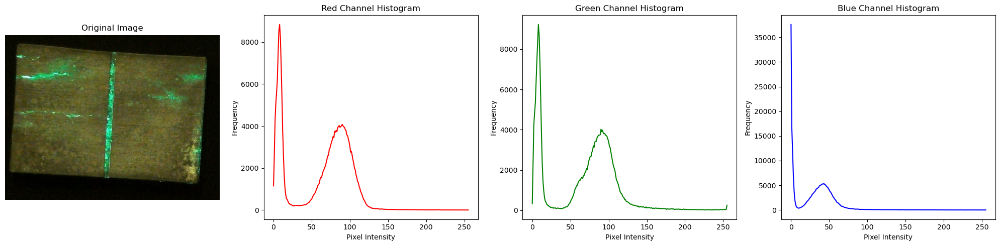

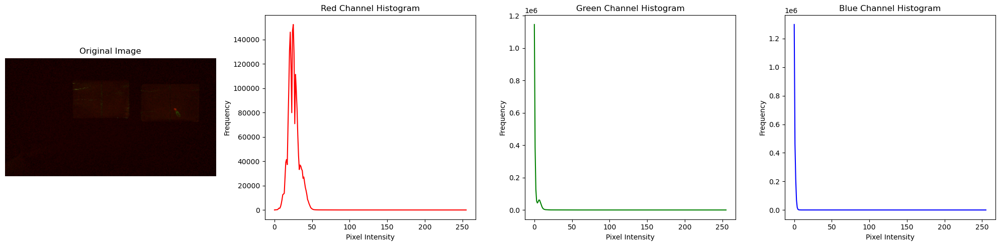

In [7]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def draw_hist_rgb_img(img_path):
    # Load the image
    image = cv2.imread(img_path)

    # Split the image into its respective channels
    b, g, r = cv2.split(image)

    # Calculate the histograms for each channel
    hist_b = cv2.calcHist([b], [0], None, [256], [0, 256])
    hist_g = cv2.calcHist([g], [0], None, [256], [0, 256])
    hist_r = cv2.calcHist([r], [0], None, [256], [0, 256])

    # Plot the original image and its histograms
    fig, axs = plt.subplots(1, 4, figsize=(20, 5))

    # Display the original image
    axs[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axs[0].set_title('Original Image')
    axs[0].axis('off')

    # Display the histogram for the Red channel
    axs[1].plot(hist_r, color='red')
    axs[1].set_title('Red Channel Histogram')
    axs[1].set_xlabel('Pixel Intensity')
    axs[1].set_ylabel('Frequency')

    # Display the histogram for the Green channel
    axs[2].plot(hist_g, color='green')
    axs[2].set_title('Green Channel Histogram')
    axs[2].set_xlabel('Pixel Intensity')
    axs[2].set_ylabel('Frequency')

    # Display the histogram for the Blue channel
    axs[3].plot(hist_b, color='blue')
    axs[3].set_title('Blue Channel Histogram')
    axs[3].set_xlabel('Pixel Intensity')
    axs[3].set_ylabel('Frequency')

    plt.tight_layout()
    plt.show()

draw_hist_rgb_img('Images/Img2.jpg')
draw_hist_rgb_img('Images/Img4.jpg')



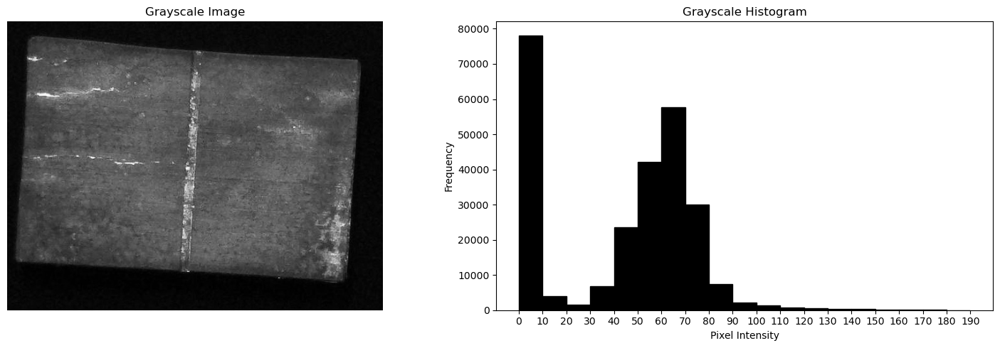

In [6]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def draw_hist_gray_img(img_path):
    # Load the image
    image = cv2.imread(img_path)

    # Convert the image to grayscale
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Calculate the histogram for the grayscale image with bins of size 10
    bins = np.arange(0, 200, 10)  # Create bins from 0 to 256 with a step size of 10
    hist_gray = cv2.calcHist([gray_image], [0], None, [len(bins)-1], [0, 256])

    # Plot the grayscale image and its histogram
    plt.figure(figsize=(15, 5))

    # Display the grayscale image
    plt.subplot(121)
    plt.imshow(gray_image, cmap='gray')
    plt.title('Grayscale Image')
    plt.axis('off')

    # Display the histogram
    plt.subplot(122)
    plt.bar(bins[:-1], hist_gray[:, 0], width=10, color='black', edgecolor='black', align='edge')
    plt.title('Grayscale Histogram')
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Frequency')
    plt.xticks(bins)  # Set the x-axis ticks to be the bin edges

    plt.tight_layout()
    plt.show()






In [ ]:
draw_hist_gray_img('Images/Img2.jpg')

Otsu method to get threshold values:

In [35]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def get_threshold_val_otsu(img_path):

    # Read the image in grayscale
    image = cv2.imread(img_path, 0)

    # Apply Otsu’s thresholding
    thresh_val, otsu_thresholded = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    print('Otsu\'s Thresholding Value: ', thresh_val)
    # # Display the original and Otsu-thresholded images
    # cv2.imshow(‘Original Image’, image)
    # cv2.imshow(‘Otsu Thresholding’, otsu_thresholded)
    # cv2.waitKey(0)
    # cv2.destroyAllWindows()
    plt.subplots(figsize=(8, 8))
    plt.imshow(image,'gray')
    plt.title('Original Image')
    #plt.xticks([]),plt.yticks([])

    # plt.subplots(figsize=(8, 8))
    # plt.hist(otsu_thresholded,256)
    # plt.title("otsu_thresholded")
    # plt.xticks([]), plt.yticks([])
    plt.subplots(figsize=(8, 8))
    plt.imshow(otsu_thresholded,'gray')
    plt.title(f'Otsu Thresholding, Threshold Value {thresh_val}')


In [19]:
import cv2
import numpy as np
from scipy.signal import find_peaks

def get_threshold_val_triangle(img_path):
    # Read the image in grayscale
    image = cv2.imread(img_path, 0)

    # Compute the histogram
    hist, bins = np.histogram(image.flatten(), 256, [0, 256])

    # Find the peak of the histogram
    peaks, _ = find_peaks(hist)

    # Calculate Triangle threshold
    triangle_threshold = (peaks[0] + np.argmax(hist[peaks[0]:])) // 2

    # Apply Triangle thresholding
    thresh_val, triangle_thresholded = cv2.threshold(image, triangle_threshold, 255, cv2.THRESH_BINARY)

    print('Triangel Thresholding Value: ', thresh_val)
    # Display the original and Triangle-thresholded images
    # cv2.imshow(‘Original Image’, image)
    # cv2.imshow(‘Triangle Thresholding’, triangle_thresholded)
    # cv2.waitKey(0)
    # cv2.destroyAllWindows()
    
    plt.subplots(figsize=(8, 8))
    plt.imshow(image,'gray')
    plt.title('Original Image')
    #plt.xticks([]),plt.yticks([])

    # plt.subplots(figsize=(8, 8))
    # plt.hist(otsu_thresholded,256)
    # plt.title("otsu_thresholded")
    # plt.xticks([]), plt.yticks([])
    plt.subplots(figsize=(8, 8))
    plt.imshow(triangle_thresholded,'gray')
    plt.title(f'Triangle Thresholding, Threshold Value {thresh_val}')




Triangel Thresholding Value:  3.0
Otsu's Thresholding Value:  46.0


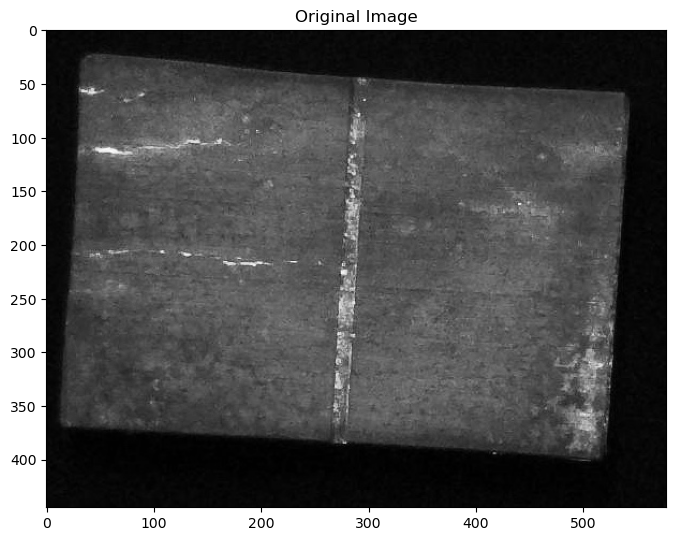

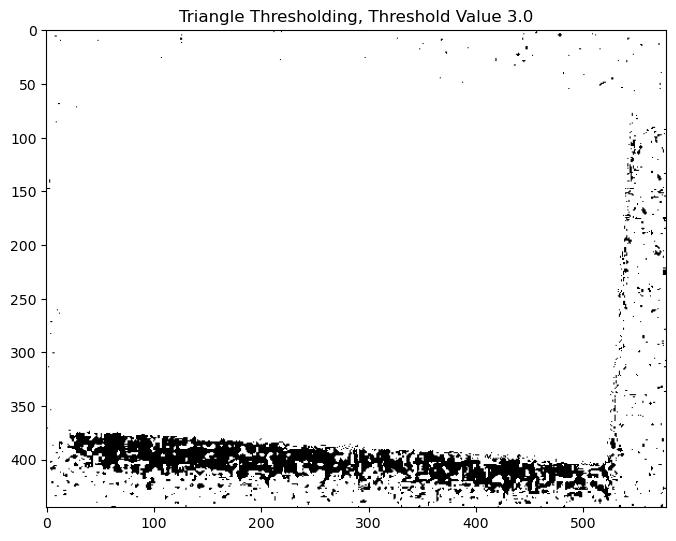

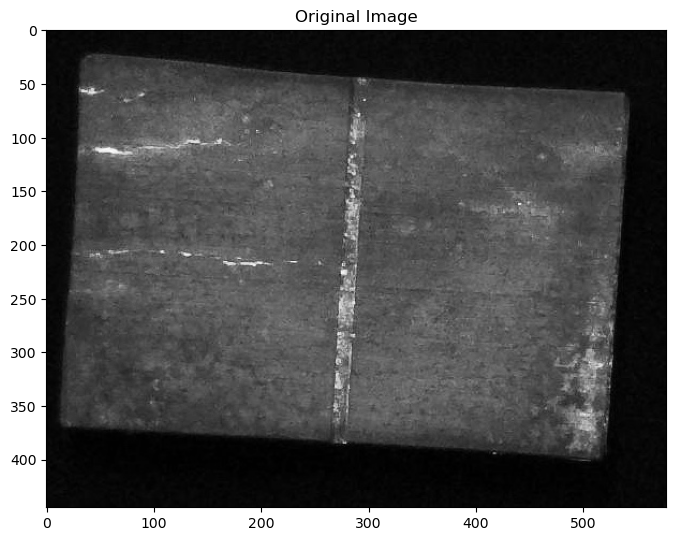

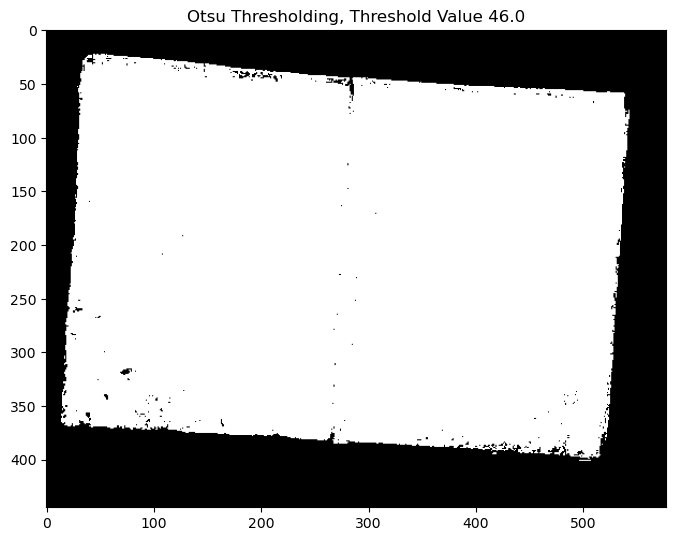

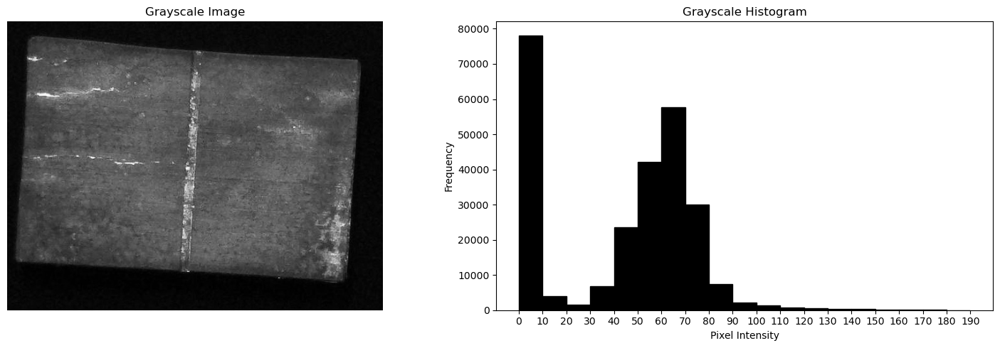

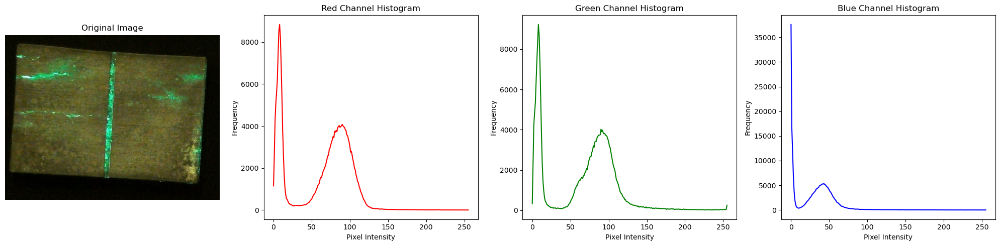

In [12]:
get_threshold_val_triangle('Images/Img2.jpg')
get_threshold_val_otsu('Images/Img2.jpg')
draw_hist_gray_img('Images/Img2.jpg')
draw_hist_rgb_img('Images/Img2.jpg')

Triangel Thresholding Value:  35.0
Otsu's Thresholding Value:  38.0


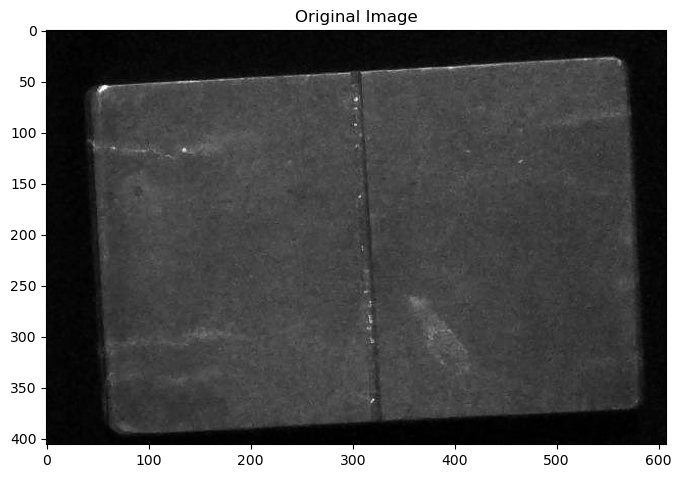

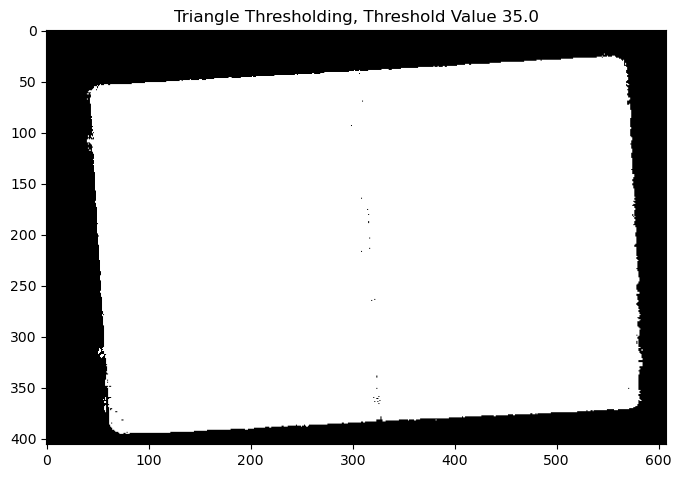

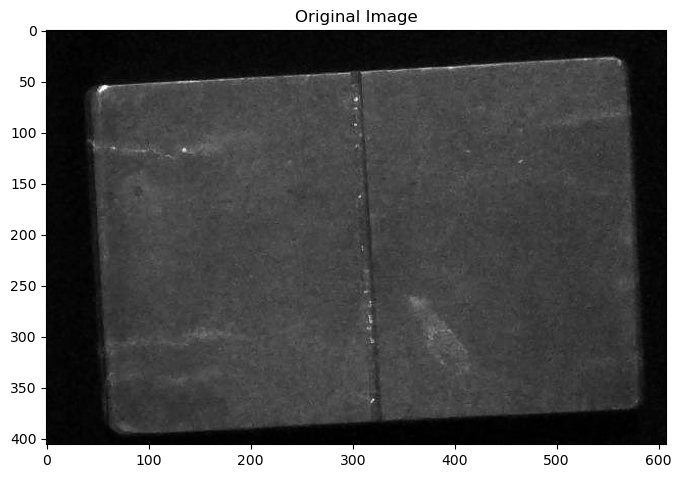

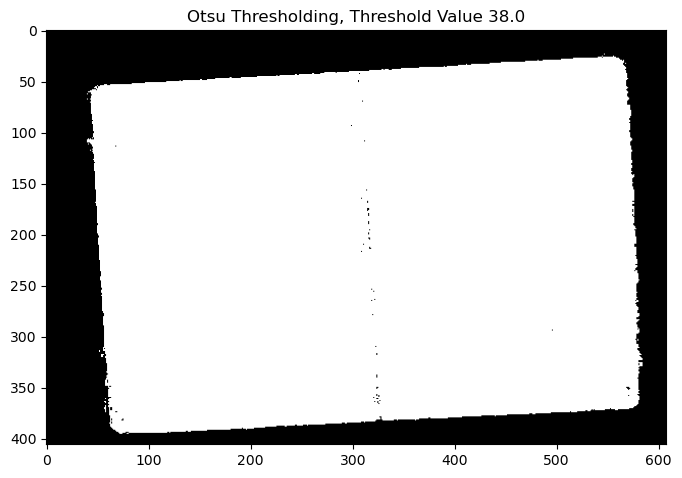

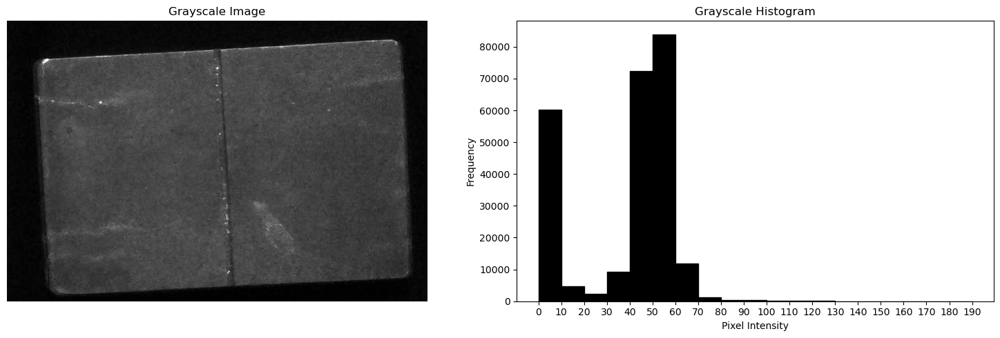

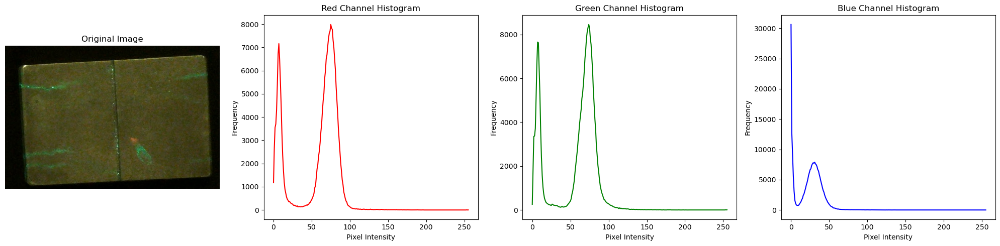

In [13]:
get_threshold_val_triangle('Images/Img3.jpg')
get_threshold_val_otsu('Images/Img3.jpg')
draw_hist_gray_img('Images/Img3.jpg')
draw_hist_rgb_img('Images/Img3.jpg')

Triangel Thresholding Value:  122.0
Otsu's Thresholding Value:  182.0


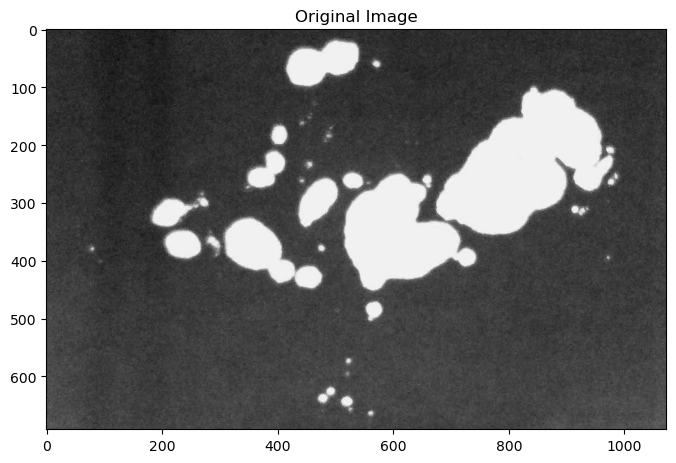

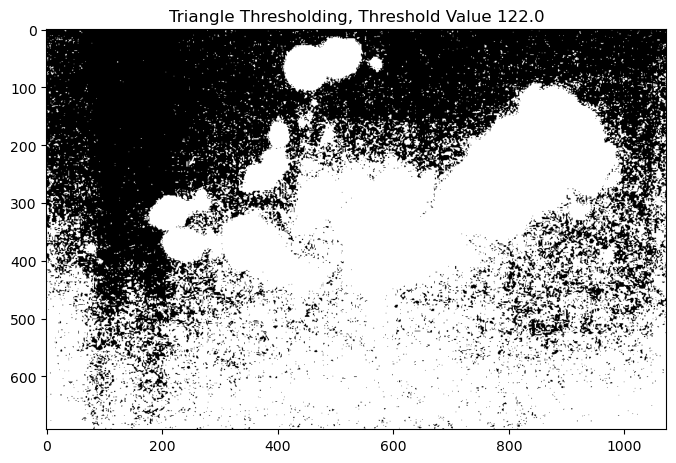

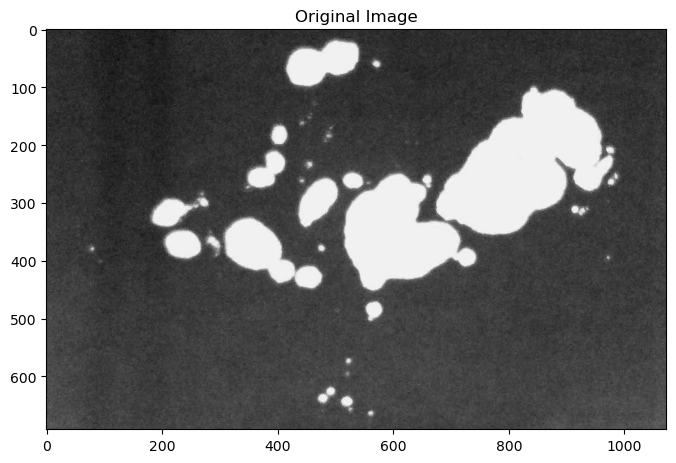

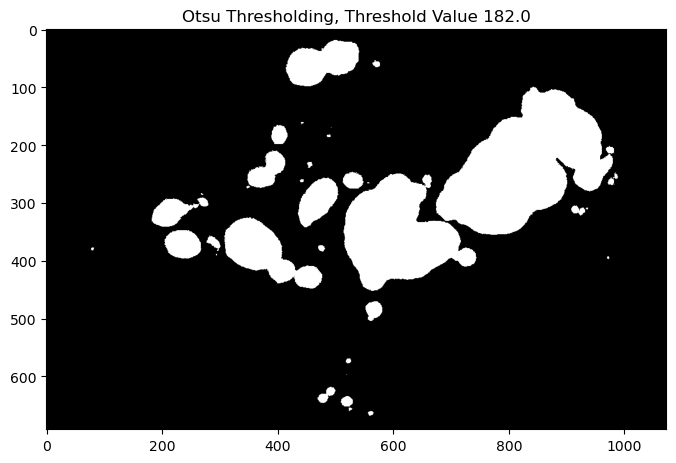

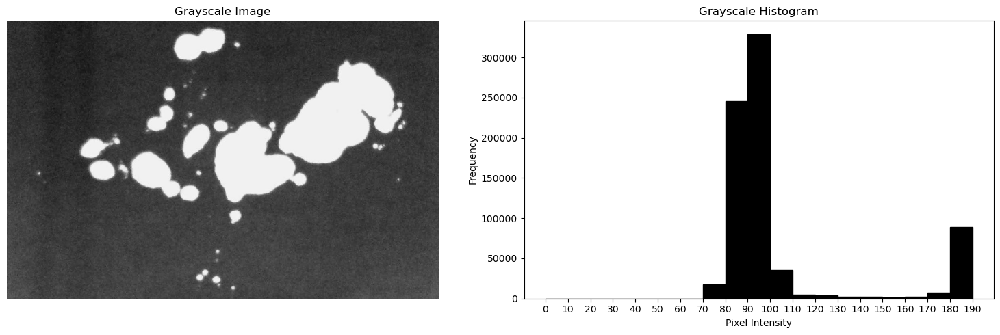

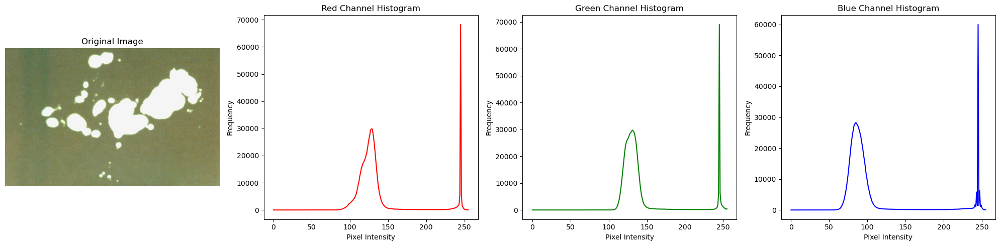

In [ ]:
get_threshold_val_triangle('Images/Img6.jpg')
get_threshold_val_otsu('Images/Img6.jpg')
draw_hist_gray_img('Images/Img6.jpg')
draw_hist_rgb_img('Images/Img6.jpg')

Triangel Thresholding Value:  122.0
Otsu's Thresholding Value:  184.0


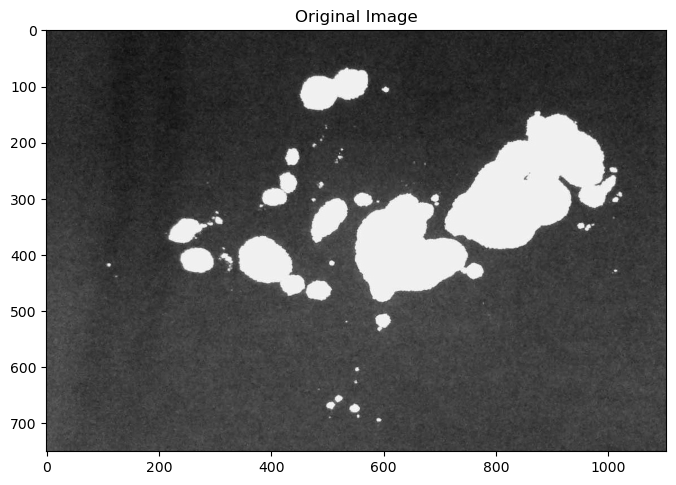

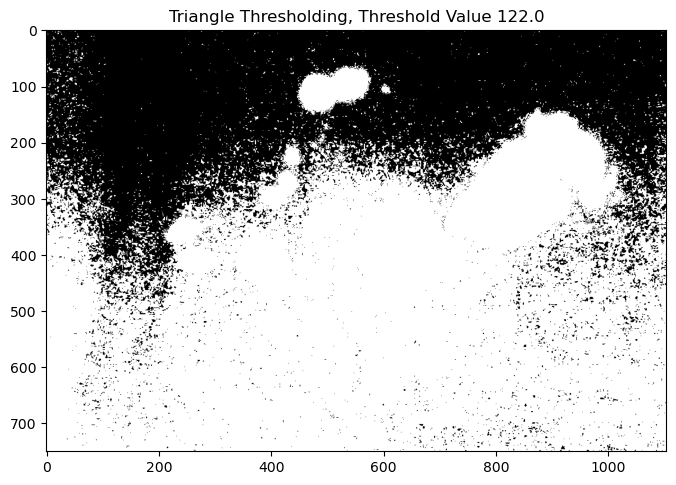

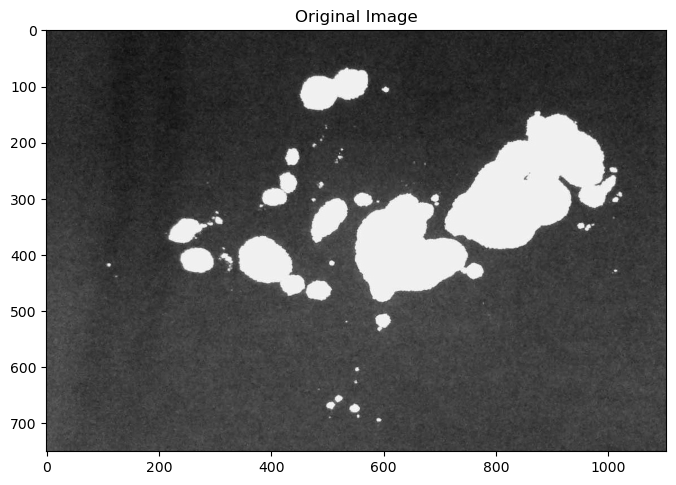

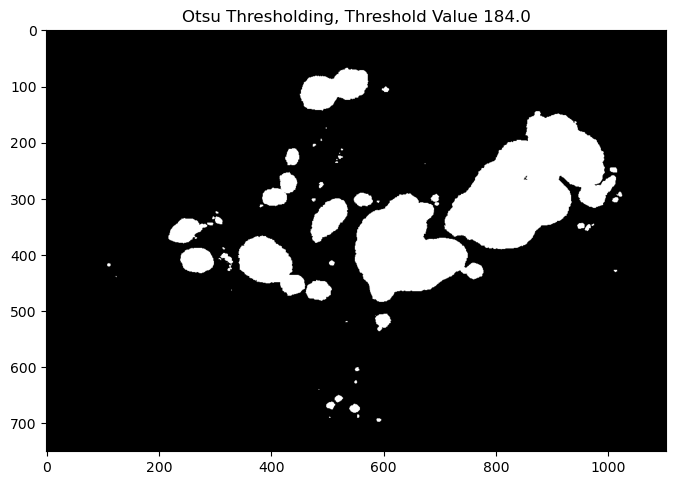

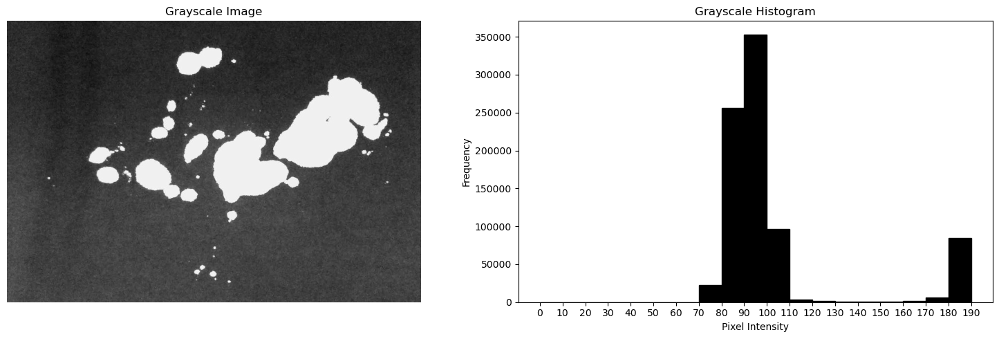

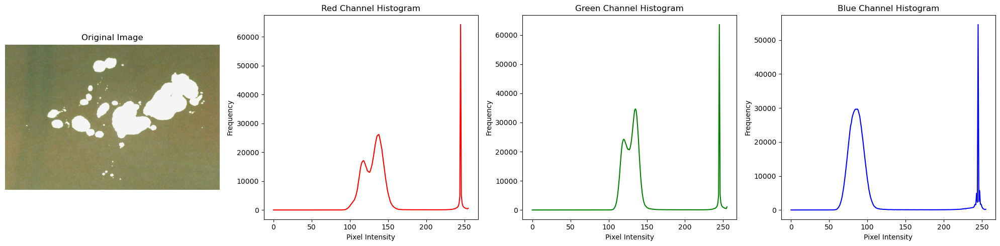

In [14]:
get_threshold_val_triangle('Images/Img7.jpg')
get_threshold_val_otsu('Images/Img7.jpg')
draw_hist_gray_img('Images/Img7.jpg')
draw_hist_rgb_img('Images/Img7.jpg')

### Testing 12-7-2024

In [9]:
image_list = []
for i in range(1, 5):
    img_name = 'Images/12-7-2024/Img'+str(i)+'.jpg'
    image_list.append(img_name)
    print(img_name)

Images/12-7-2024/Img1.jpg
Images/12-7-2024/Img2.jpg
Images/12-7-2024/Img3.jpg
Images/12-7-2024/Img4.jpg


In [ ]:
for img in image_list:
    get_threshold_val_triangle(img)
    get_threshold_val_otsu(img)
    draw_hist_gray_img(img)
    draw_hist_rgb_img(img)

In [69]:
from scipy import ndimage 

def get_threshold_val_triangle_v1(img_path):
    # Read the image in grayscale
    image = cv2.imread(img_path)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    #Contrast limited adaptive histogram equalization (CLAHE) is a technique for increasing the visibility of a foggy image or video.Image enhancement
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8, 8))
    enhanced_image = clahe.apply(gray_image)
    # Compute the histogram
    hist, bins = np.histogram(enhanced_image.flatten(), 256, [0, 256])
    # Apply Gaussian blur to reduce noise
    

    # Find the peak of the histogram
    peaks, _ = find_peaks(hist)

    # Calculate Triangle threshold
    triangle_threshold = (peaks[0] + np.argmax(hist[peaks[0]:])) // 2

    # Apply Triangle thresholding
    thresh_val, triangle_thresholded = cv2.threshold(enhanced_image, triangle_threshold, 255, cv2.THRESH_BINARY)

    print('V1 Triangel Thresholding Value: ', thresh_val)
    plt.subplots(figsize=(8, 8))
    plt.imshow(gray_image)
    plt.title('Original Image')
    plt.subplots(figsize=(8, 8))
    plt.imshow(triangle_thresholded,'gray')
    plt.title(f'V1 Triangle Thresholding, Threshold Value {thresh_val}')

def get_threshold_val_triangle_v2(img_path):
    # Read the image in grayscale
    image = cv2.imread(img_path)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    #Contrast limited adaptive histogram equalization (CLAHE) is a technique for increasing the visibility of a foggy image or video.Image enhancement
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8, 8))
    enhanced_image = clahe.apply(gray_image)
    # Apply Gaussian blur to reduce noise
    blurred = cv2.GaussianBlur(enhanced_image, (3, 3), 0)
    # Compute the histogram
    hist, bins = np.histogram(blurred.flatten(), 256, [0, 256])
   

    # Find the peak of the histogram
    peaks, _ = find_peaks(hist)

    # Calculate Triangle threshold
    triangle_threshold = (peaks[0] + np.argmax(hist[peaks[0]:])) // 2

    # Apply Triangle thresholding
    thresh_val, triangle_thresholded = cv2.threshold(blurred, triangle_threshold, 255, cv2.THRESH_BINARY)

    print('V2 Triangel Thresholding Value: ', thresh_val)
    plt.subplots(figsize=(8, 8))
    plt.imshow(gray_image)
    plt.title('Original Image')
    plt.subplots(figsize=(8, 8))
    plt.imshow(triangle_thresholded,'gray')
    plt.title(f'V2 Triangle Thresholding, Threshold Value {thresh_val}')
    
def roberts_cross(image):
    """Apply the Roberts Cross operator to an image."""
    kernel_x = np.array([[1, 0], [0, -1]], dtype=int)
    kernel_y = np.array([[0, 1], [-1, 0]], dtype=int)
    
    img_x = cv2.filter2D(image, cv2.CV_64F, kernel_x)
    img_y = cv2.filter2D(image, cv2.CV_64F, kernel_y)
    
    return np.sqrt(img_x ** 2 + img_y ** 2)

def get_threshold_val_triangle_v3(img_path):
    # Read the image in grayscale
    image = cv2.imread(img_path)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    #----
    # Apply Roberts Cross operator
    edges = roberts_cross(gray_image)

    # Normalize the result to the range 0 to 255
    edges = cv2.normalize(edges, None, 0, 255, cv2.NORM_MINMAX)

    # Convert edges to 8-bit unsigned integer
    edges = edges.astype(np.uint8)

    #----
    # Compute the histogram
    hist, bins = np.histogram(edges.flatten(), 256, [0, 256])

    # Find the peak of the histogram
    peaks, _ = find_peaks(hist)

    # Calculate Triangle threshold
    triangle_threshold = (peaks[0] + np.argmax(hist[peaks[0]:])) // 2

    # Apply Triangle thresholding
    thresh_val, triangle_thresholded = cv2.threshold(edges, triangle_threshold, 255, cv2.THRESH_BINARY)

    print('V3 Triangel Thresholding Value: ', thresh_val)
    
    plt.subplots(figsize=(8, 8))
    plt.imshow(gray_image)
    plt.title('Original Image')
    plt.subplots(figsize=(8, 8))
    plt.imshow(triangle_thresholded,'gray')
    plt.title(f'V3 Triangle Thresholding, Threshold Value {thresh_val}')

def get_threshold_val_otsu_v1(img_path):
    image = cv2.imread(img_path)
    # Read the image in grayscale
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    #Contrast limited adaptive histogram equalization (CLAHE) is a technique for increasing the visibility of a foggy image or video.Image enhancement
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8, 8))
    enhanced_image = clahe.apply(gray_image)
  
    # Apply Otsu’s thresholding
    thresh_val, otsu_thresholded = cv2.threshold(enhanced_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    print('V1 Otsu\'s Thresholding Value: ', thresh_val)
    
    plt.subplots(figsize=(8, 8))
    plt.imshow(gray_image,'gray')
    plt.title('Original Image')

    plt.subplots(figsize=(8, 8))
    plt.imshow(otsu_thresholded,'gray')
    plt.title(f'V1 Otsu Thresholding, Threshold Value {thresh_val}')

def get_threshold_val_otsu_v2(img_path):
    image = cv2.imread(img_path)
    # Read the image in grayscale
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    #Contrast limited adaptive histogram equalization (CLAHE) is a technique for increasing the visibility of a foggy image or video.Image enhancement
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8, 8))
    enhanced_image = clahe.apply(gray_image)
    # Apply Gaussian blur to reduce noise
    blurred = cv2.GaussianBlur(enhanced_image, (3, 3), 0)
    # Apply Otsu’s thresholding
    thresh_val, otsu_thresholded = cv2.threshold(blurred, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    print('V2 Otsu\'s Thresholding Value: ', thresh_val)
    
    plt.subplots(figsize=(8, 8))
    plt.imshow(gray_image,'gray')
    plt.title('Original Image')

    plt.subplots(figsize=(8, 8))
    plt.imshow(otsu_thresholded,'gray')
    plt.title(f'V2 Otsu Thresholding, Threshold Value {thresh_val}')

def get_threshold_val_otsu_v3(img_path):

    # Read the image in grayscale
    image = cv2.imread(img_path)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    #----
    # roberts_cross_v = np.array( [[1, 0 ], 
    #                          [0,-1 ]] ) 
  
    # roberts_cross_h = np.array( [[ 0, 1 ], 
    #                             [ -1, 0 ]] ) 

    # vertical = ndimage.convolve( gray_image, roberts_cross_v ) 
    # horizontal = ndimage.convolve( gray_image, roberts_cross_h ) 
    
    # edged_img = np.sqrt( np.square(horizontal) + np.square(vertical)) 
    #----
    # Apply Roberts Cross operator
    edges = roberts_cross(gray_image)

    # Normalize the result to the range 0 to 255
    edges = cv2.normalize(edges, None, 0, 255, cv2.NORM_MINMAX)

    # Convert edges to 8-bit unsigned integer
    edges = edges.astype(np.uint8)

    #----
   
    # Apply Otsu’s thresholding
    thresh_val, otsu_thresholded = cv2.threshold(edges, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    print('V3 Otsu\'s Thresholding Value: ', thresh_val)
    plt.subplots(figsize=(8, 8))
    plt.imshow(gray_image)
    plt.title('Original Image')
    plt.subplots(figsize=(8, 8))
    plt.imshow(otsu_thresholded,'gray')
    plt.title(f'V3 Otsu Thresholding, Threshold Value {thresh_val}')





V1 Triangel Thresholding Value:  3.0
V1 Otsu's Thresholding Value:  18.0
V2 Triangel Thresholding Value:  3.0
V2 Otsu's Thresholding Value:  17.0
V3 Triangel Thresholding Value:  7.0
V3 Otsu's Thresholding Value:  47.0


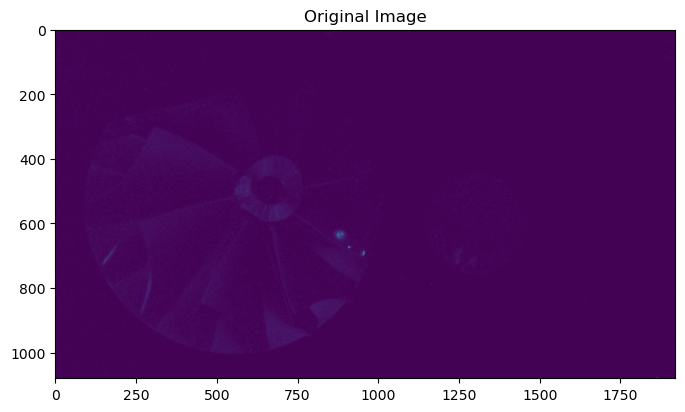

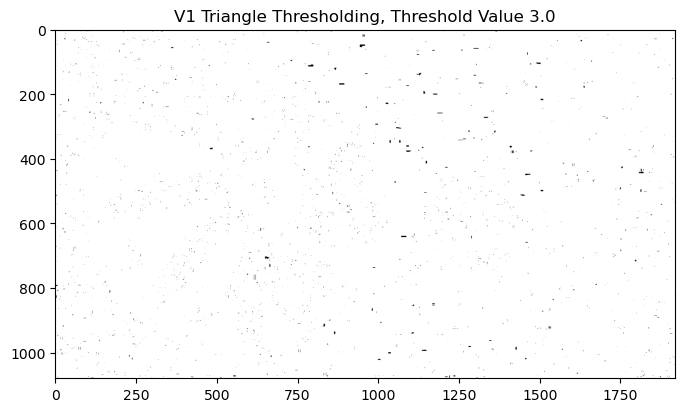

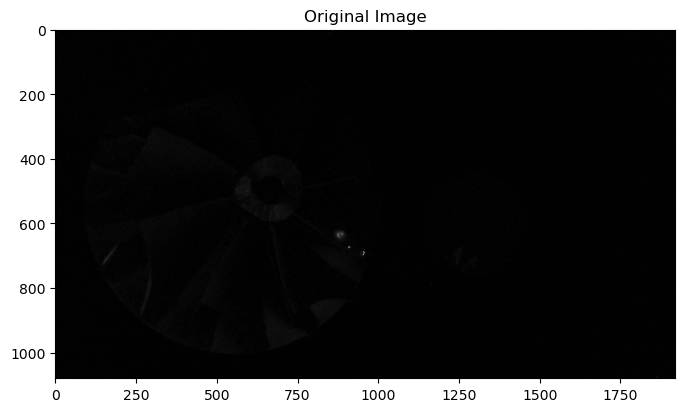

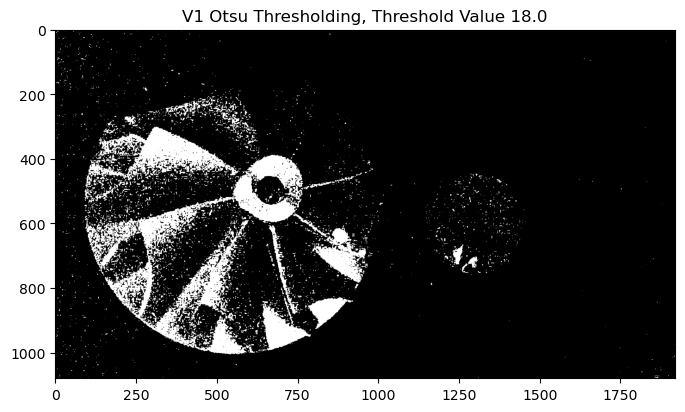

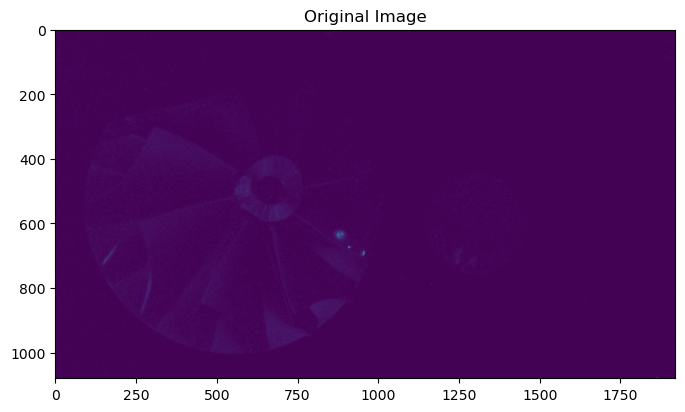

...

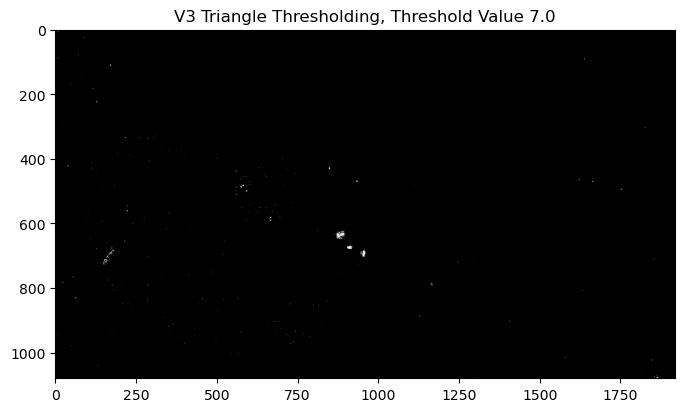

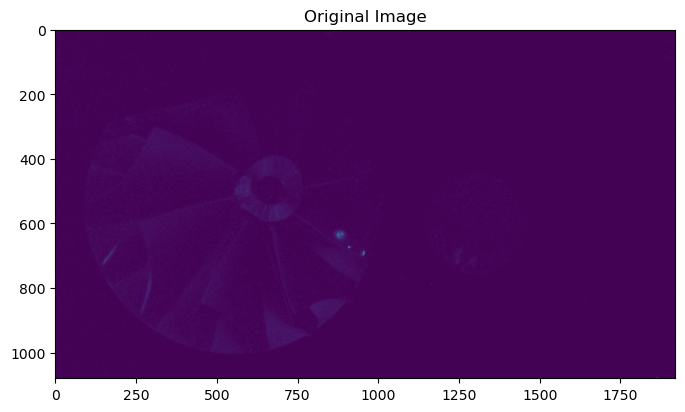

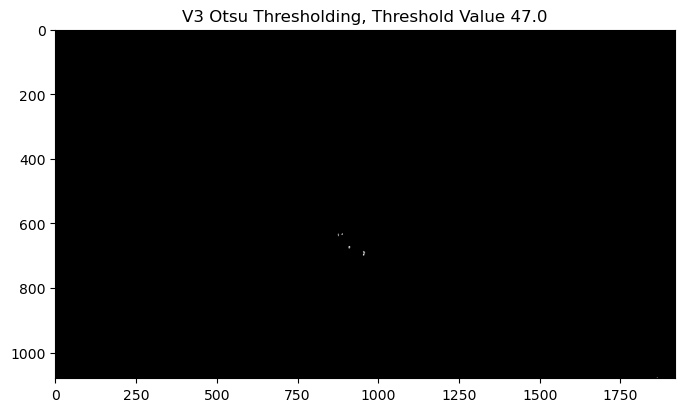

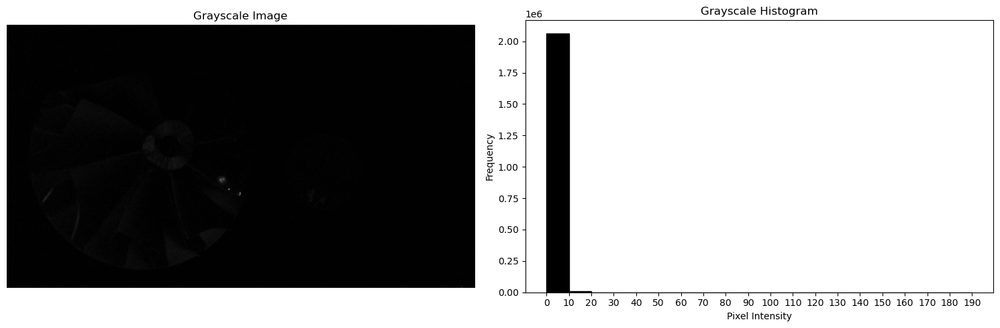

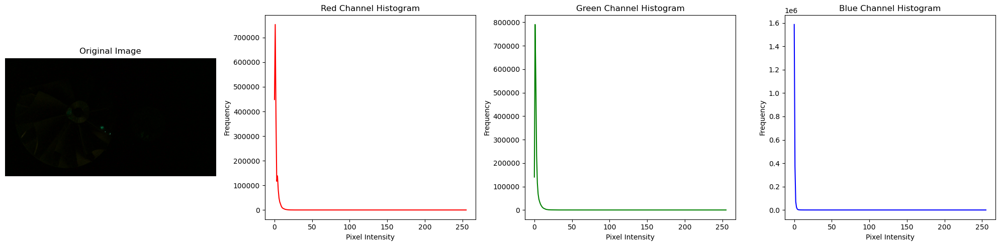

In [78]:
get_threshold_val_triangle_v1('Images/12-7-2024/Img16.jpg')
get_threshold_val_otsu_v1('Images/12-7-2024/Img16.jpg')
get_threshold_val_triangle_v2('Images/12-7-2024/Img16.jpg')
get_threshold_val_otsu_v2('Images/12-7-2024/Img16.jpg')
get_threshold_val_triangle_v3('Images/12-7-2024/Img16.jpg')

get_threshold_val_otsu_v3('Images/12-7-2024/Img16.jpg')
draw_hist_gray_img('Images/12-7-2024/Img16.jpg')
draw_hist_rgb_img('Images/12-7-2024/Img16.jpg')


# V2 and V3 works fine for this image

V1 Triangel Thresholding Value:  3.0
V1 Otsu's Thresholding Value:  19.0
V2 Triangel Thresholding Value:  3.0
V2 Otsu's Thresholding Value:  18.0
V3 Triangel Thresholding Value:  1.0
V3 Otsu's Thresholding Value:  1.0


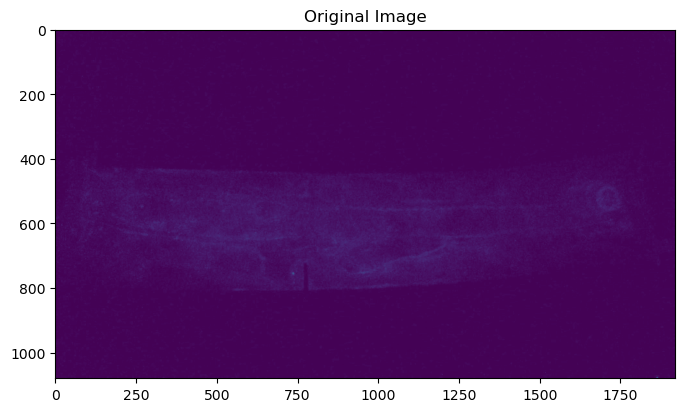

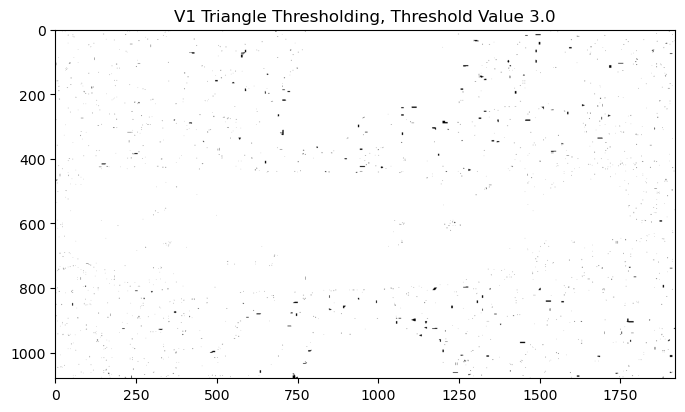

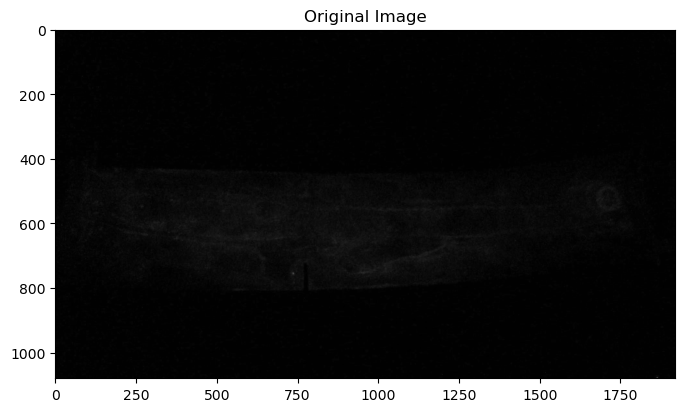

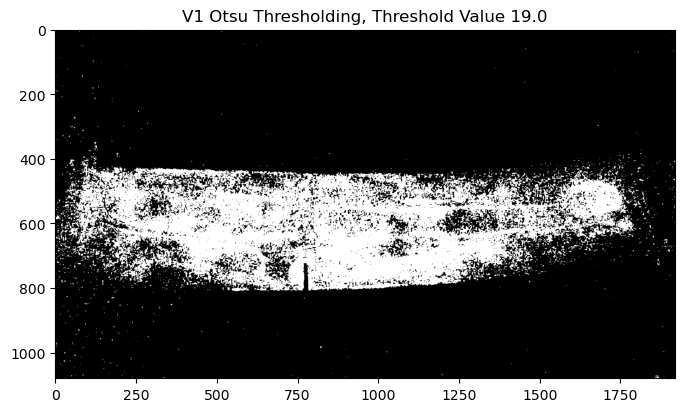

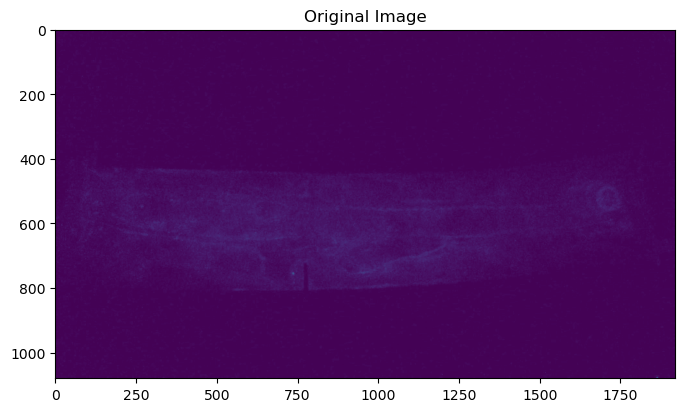

...

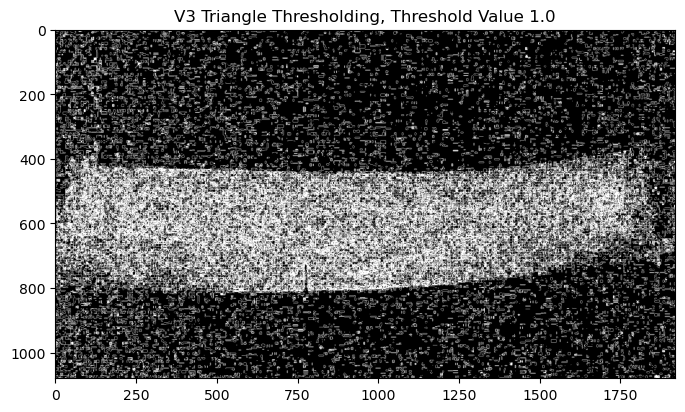

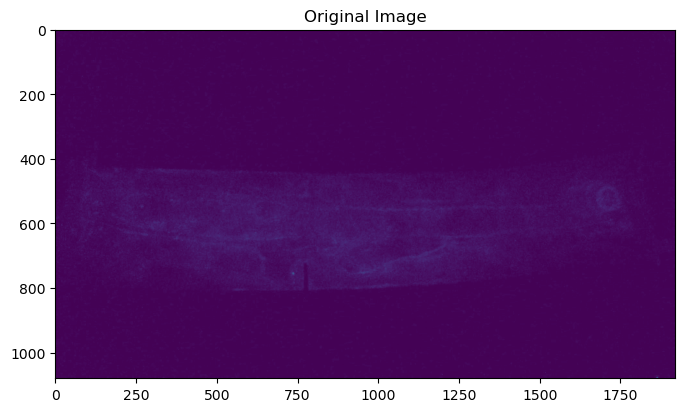

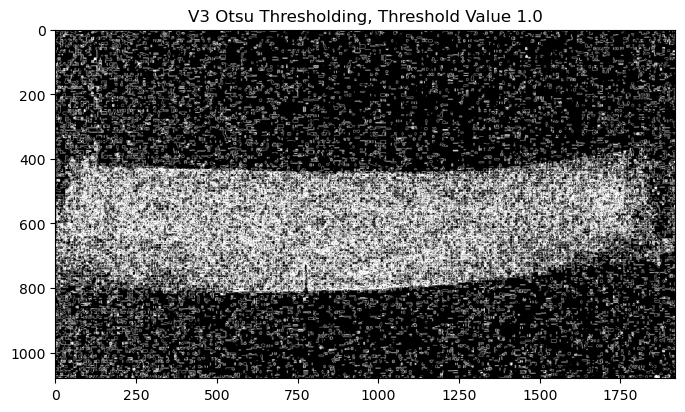

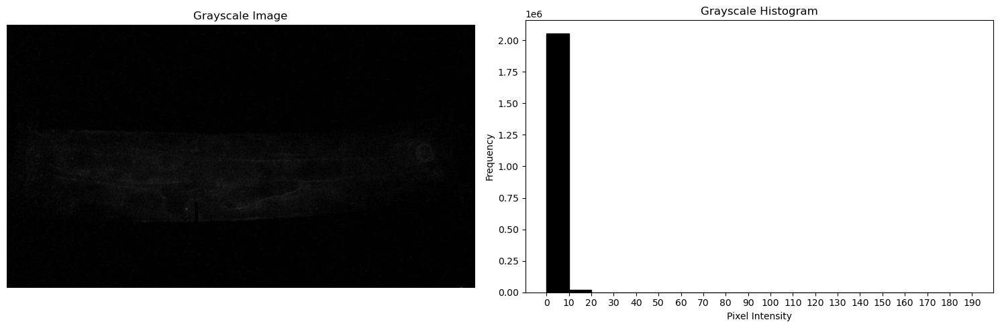

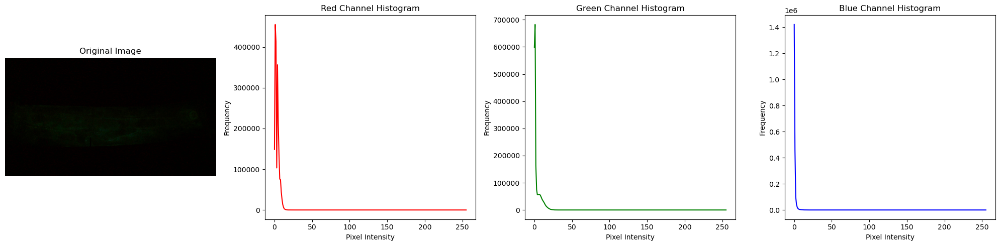

In [80]:
get_threshold_val_triangle_v1('Images/12-7-2024/Img21.jpg')
get_threshold_val_otsu_v1('Images/12-7-2024/Img21.jpg')
get_threshold_val_triangle_v2('Images/12-7-2024/Img21.jpg')
get_threshold_val_otsu_v2('Images/12-7-2024/Img21.jpg')
get_threshold_val_triangle_v3('Images/12-7-2024/Img21.jpg')
get_threshold_val_otsu_v3('Images/12-7-2024/Img21.jpg')
draw_hist_gray_img('Images/12-7-2024/Img21.jpg')
draw_hist_rgb_img('Images/12-7-2024/Img21.jpg')

# V2 and V3 works fine

V1 Triangel Thresholding Value:  2.0
V1 Otsu's Thresholding Value:  15.0
V2 Triangel Thresholding Value:  3.0
V2 Otsu's Thresholding Value:  14.0
V3 Triangel Thresholding Value:  3.0
V3 Otsu's Thresholding Value:  49.0


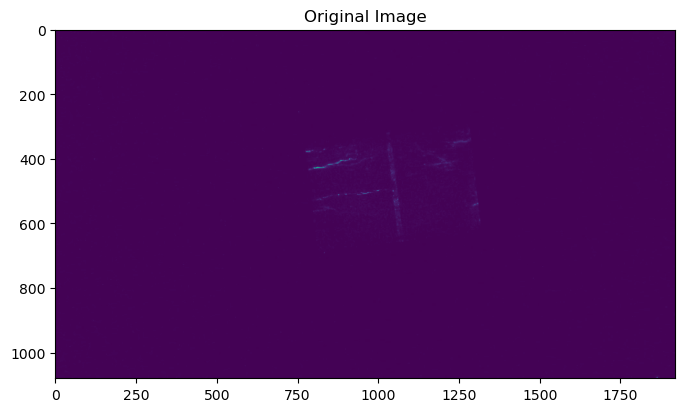

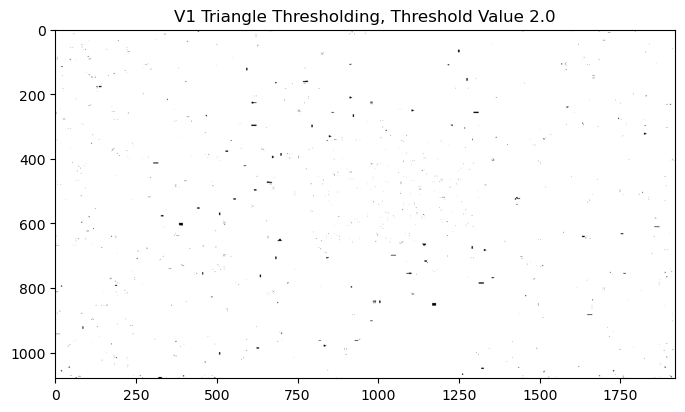

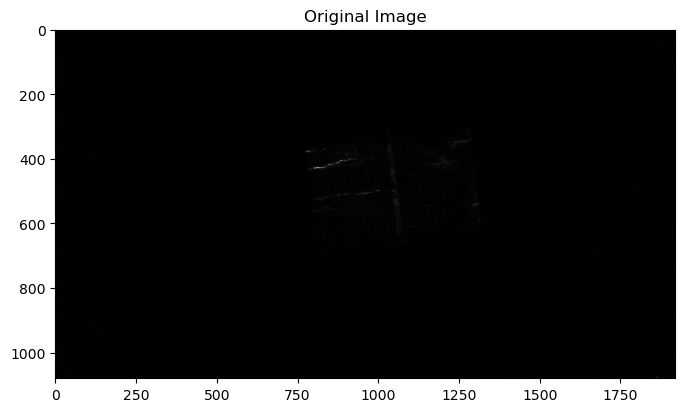

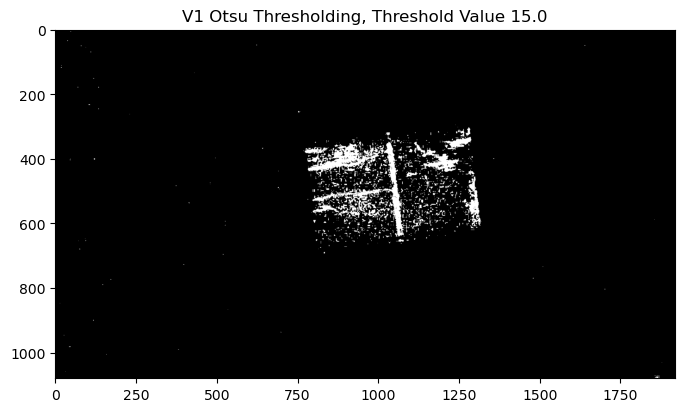

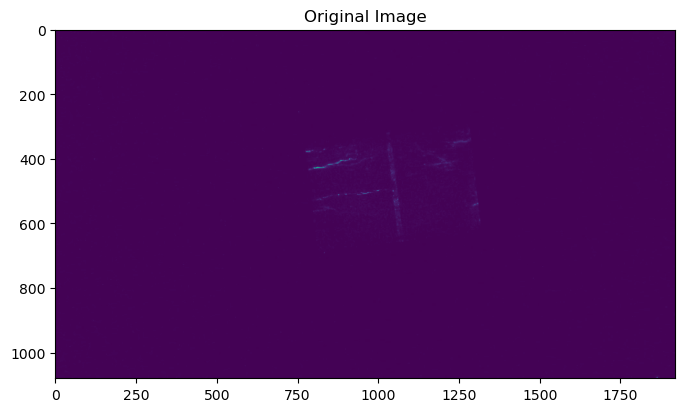

...

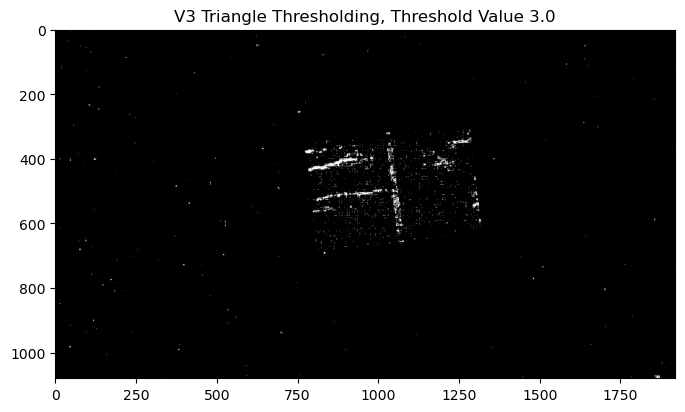

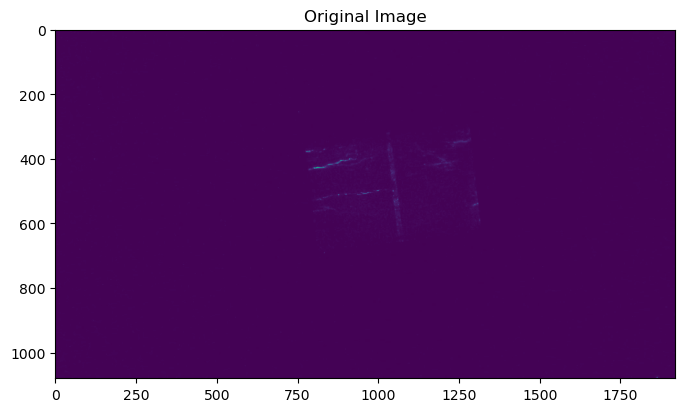

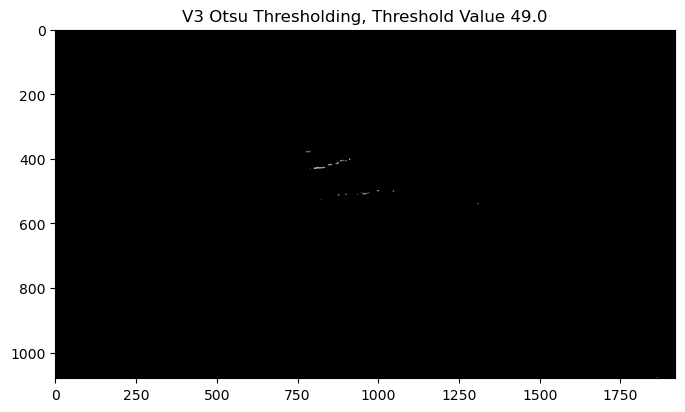

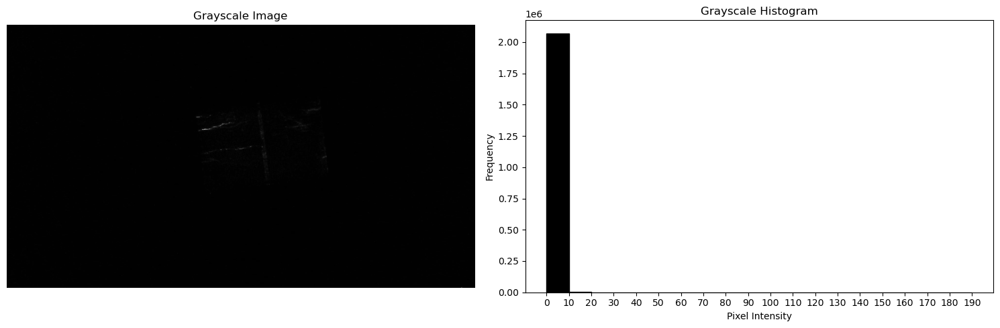

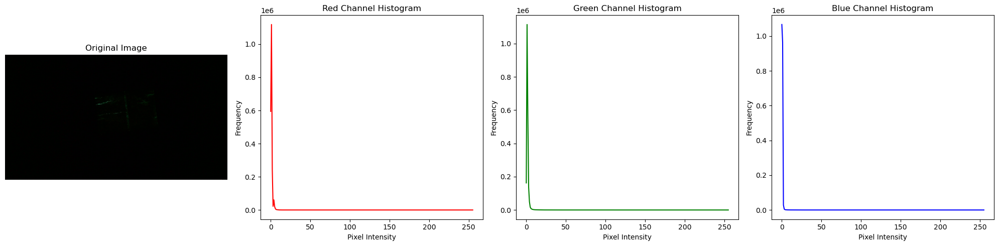

In [82]:
get_threshold_val_triangle_v1('Images/12-7-2024/Img22.jpg')
get_threshold_val_otsu_v1('Images/12-7-2024/Img22.jpg')
get_threshold_val_triangle_v2('Images/12-7-2024/Img22.jpg')
get_threshold_val_otsu_v2('Images/12-7-2024/Img22.jpg')
get_threshold_val_triangle_v3('Images/12-7-2024/Img22.jpg')
get_threshold_val_otsu_v3('Images/12-7-2024/Img22.jpg')
draw_hist_gray_img('Images/12-7-2024/Img22.jpg')
draw_hist_rgb_img('Images/12-7-2024/Img22.jpg')

# V2 and V3 works fine for this

V1 Triangel Thresholding Value:  3.0
V1 Otsu's Thresholding Value:  7.0
V2 Triangel Thresholding Value:  3.0
V2 Otsu's Thresholding Value:  7.0
V3 Triangel Thresholding Value:  1.0
V3 Otsu's Thresholding Value:  1.0


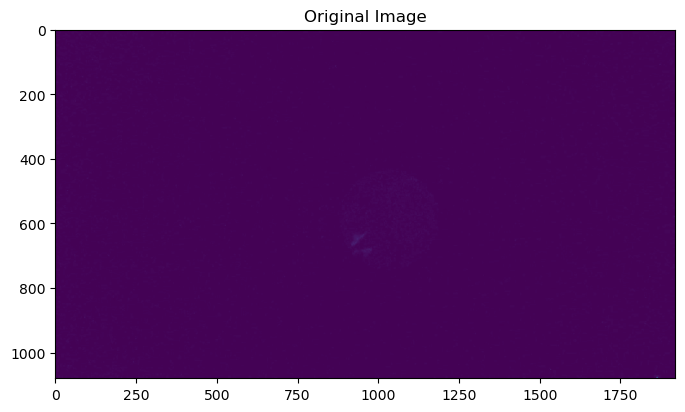

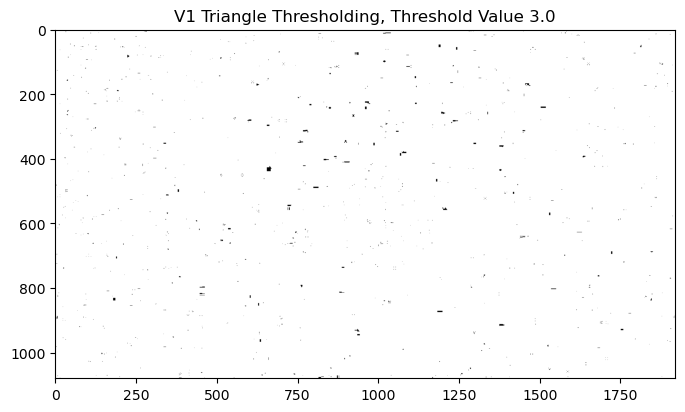

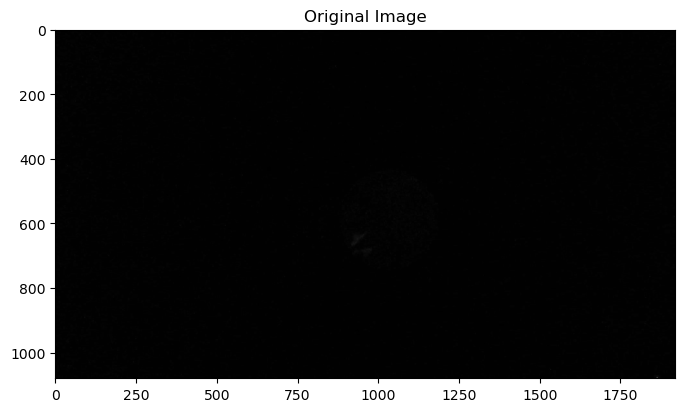

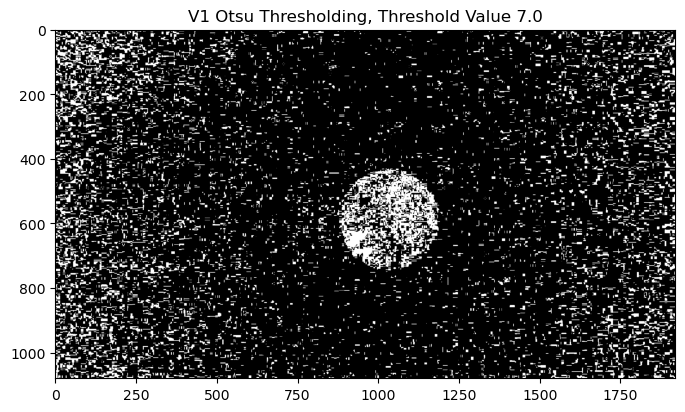

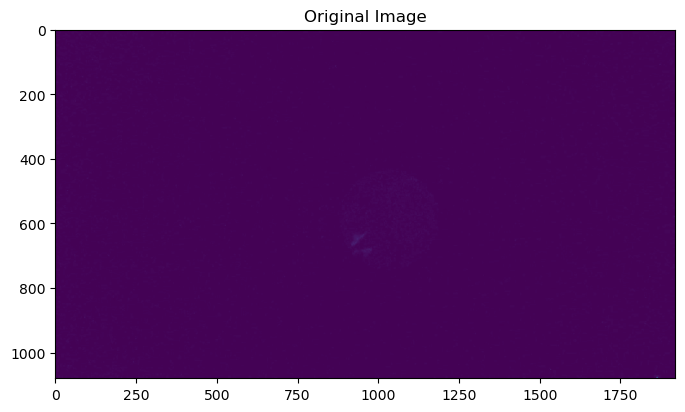

...

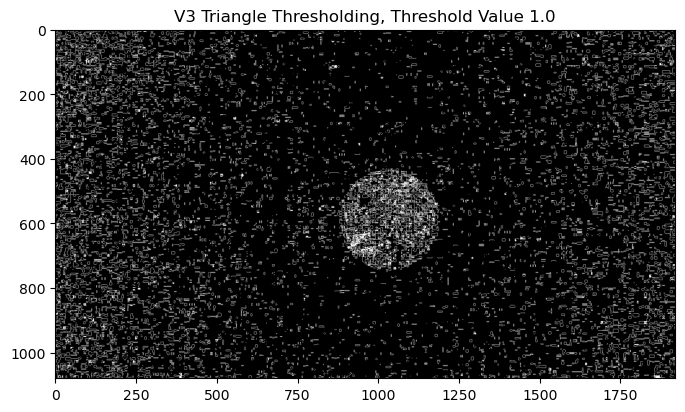

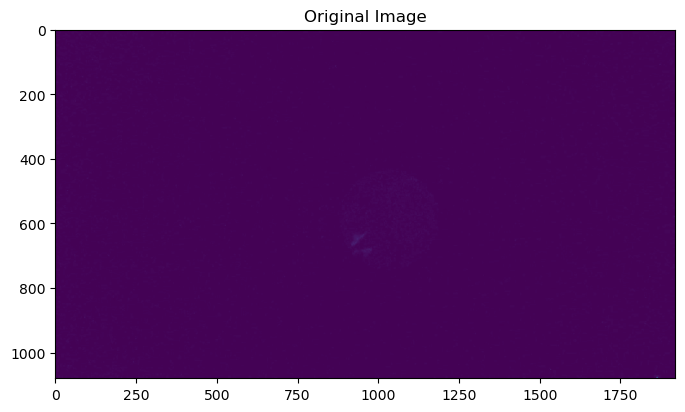

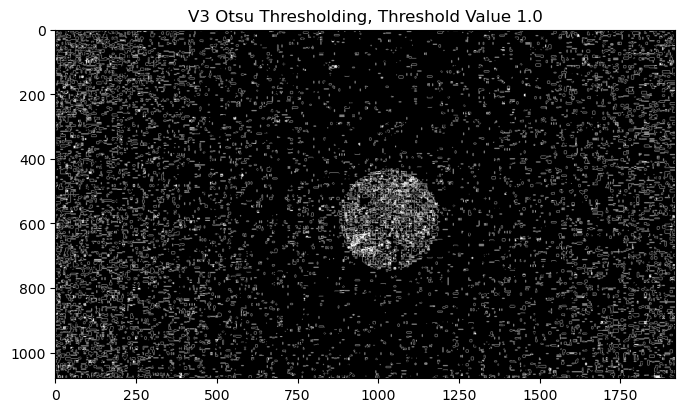

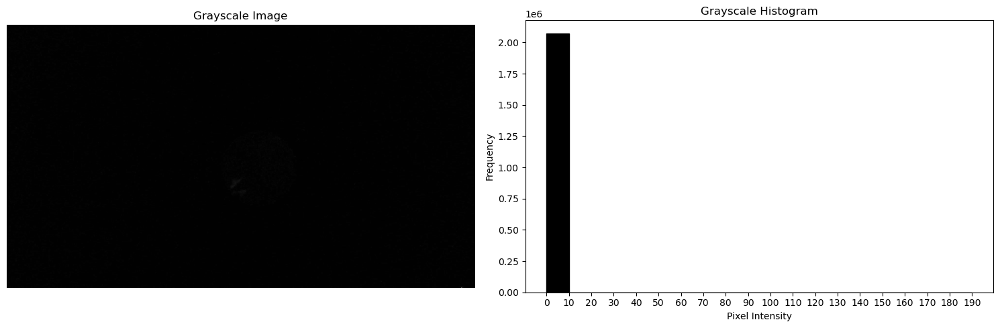

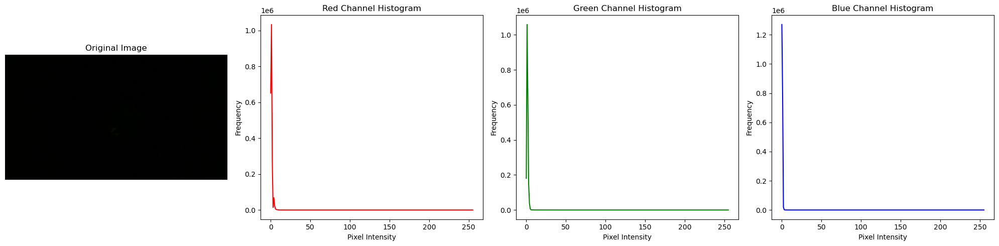

In [77]:
get_threshold_val_triangle_v1('Images/12-7-2024/Img20.jpg')
get_threshold_val_otsu_v1('Images/12-7-2024/Img20.jpg')
get_threshold_val_triangle_v2('Images/12-7-2024/Img20.jpg')
get_threshold_val_otsu_v2('Images/12-7-2024/Img20.jpg')
get_threshold_val_triangle_v3('Images/12-7-2024/Img20.jpg')
get_threshold_val_otsu_v3('Images/12-7-2024/Img20.jpg')
draw_hist_gray_img('Images/12-7-2024/Img20.jpg')
draw_hist_rgb_img('Images/12-7-2024/Img20.jpg')

V1 Triangel Thresholding Value:  6.0
V1 Otsu's Thresholding Value:  42.0
V2 Triangel Thresholding Value:  6.0
V2 Otsu's Thresholding Value:  41.0
V3 Triangel Thresholding Value:  11.0
V3 Otsu's Thresholding Value:  3.0


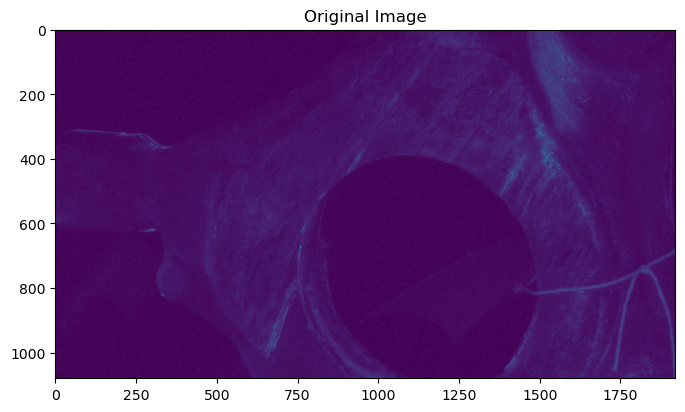

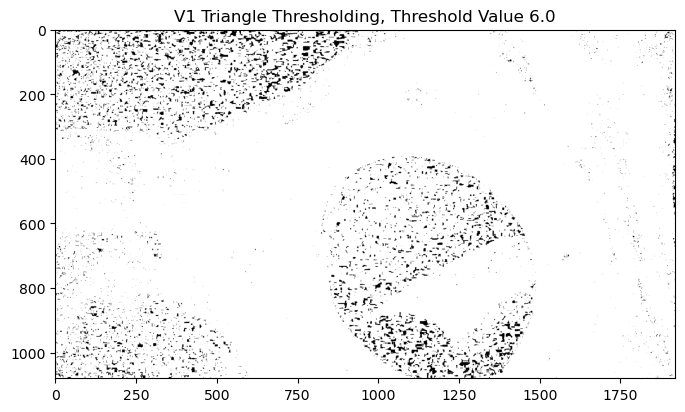

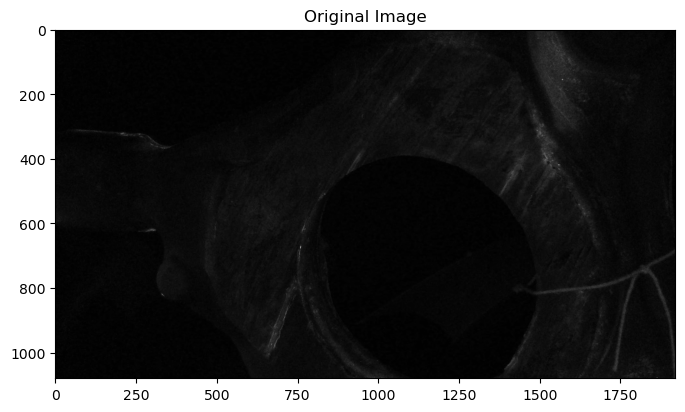

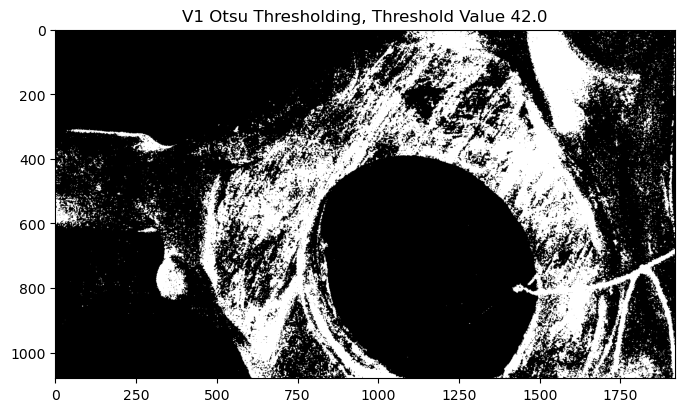

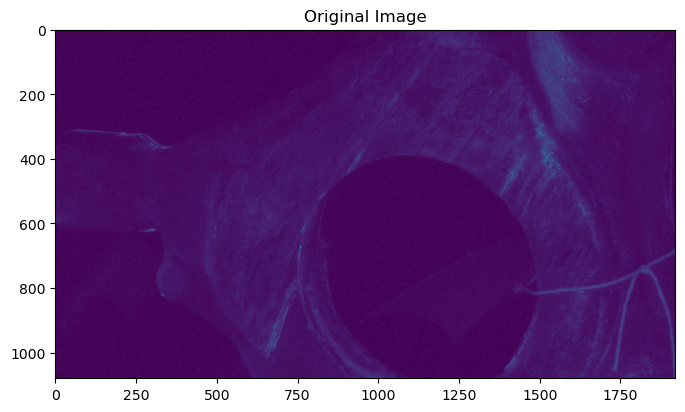

...

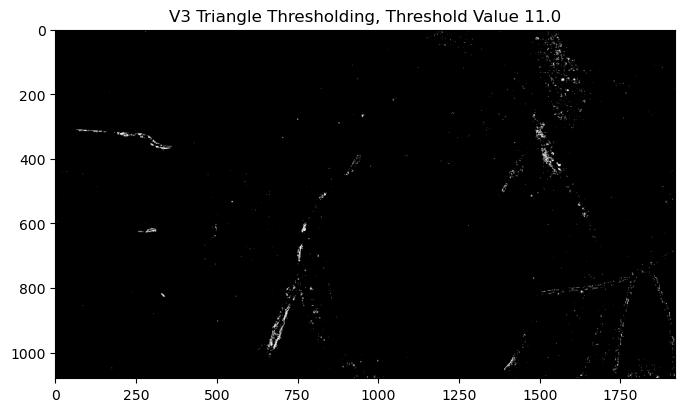

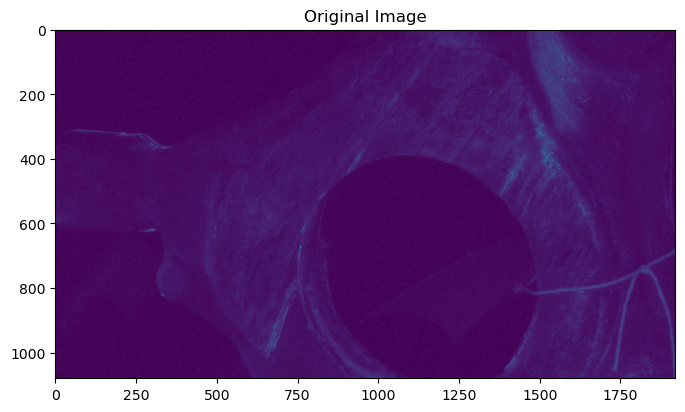

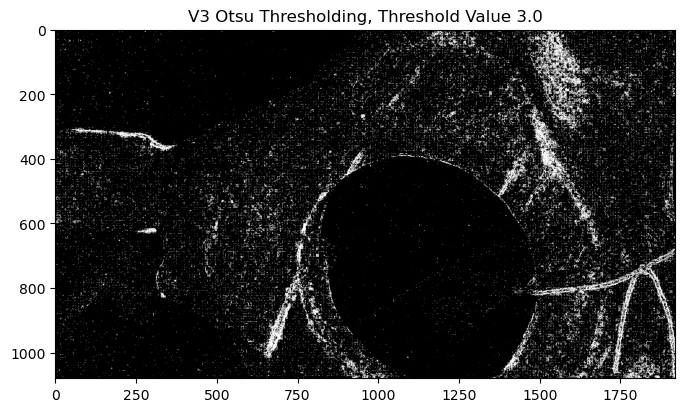

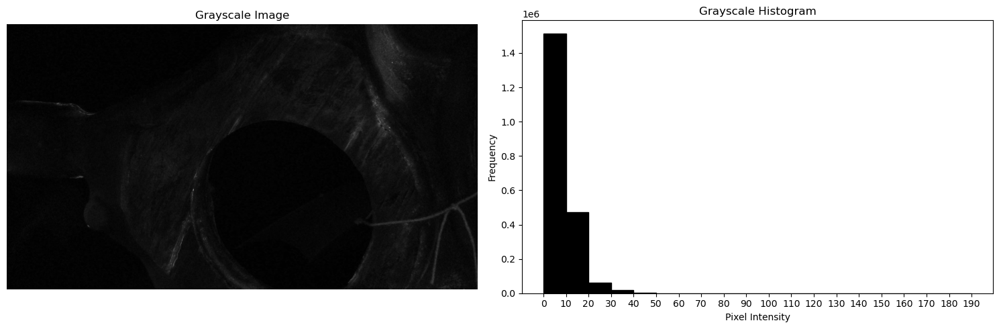

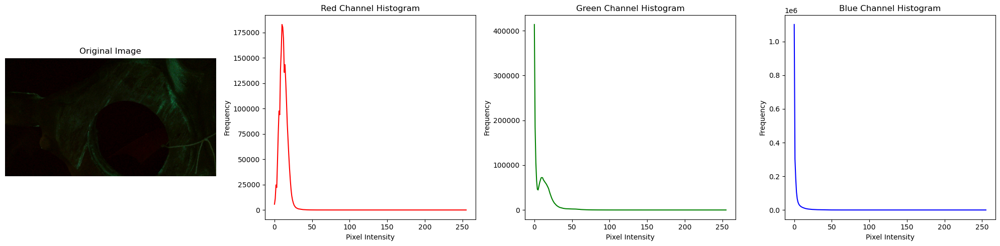

In [83]:
get_threshold_val_triangle_v1('Images/12-7-2024/Img23.jpg')
get_threshold_val_otsu_v1('Images/12-7-2024/Img23.jpg')
get_threshold_val_triangle_v2('Images/12-7-2024/Img23.jpg')
get_threshold_val_otsu_v2('Images/12-7-2024/Img23.jpg')
get_threshold_val_triangle_v3('Images/12-7-2024/Img23.jpg')
get_threshold_val_otsu_v3('Images/12-7-2024/Img23.jpg')
draw_hist_gray_img('Images/12-7-2024/Img23.jpg')
draw_hist_rgb_img('Images/12-7-2024/Img23.jpg')

V1 Triangel Thresholding Value:  3.0
V1 Otsu's Thresholding Value:  14.0
V2 Triangel Thresholding Value:  3.0
V2 Otsu's Thresholding Value:  14.0
V3 Triangel Thresholding Value:  9.0
V3 Otsu's Thresholding Value:  2.0


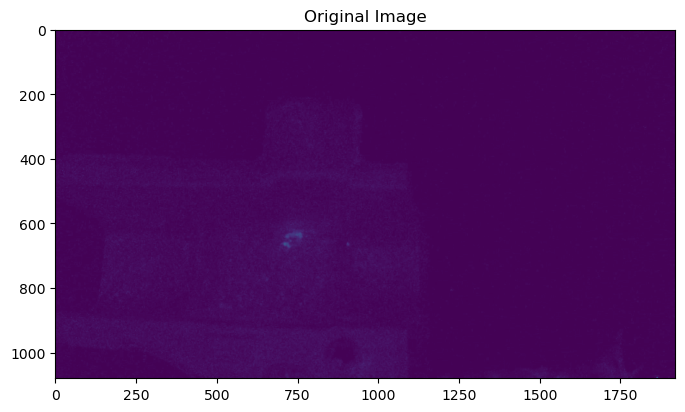

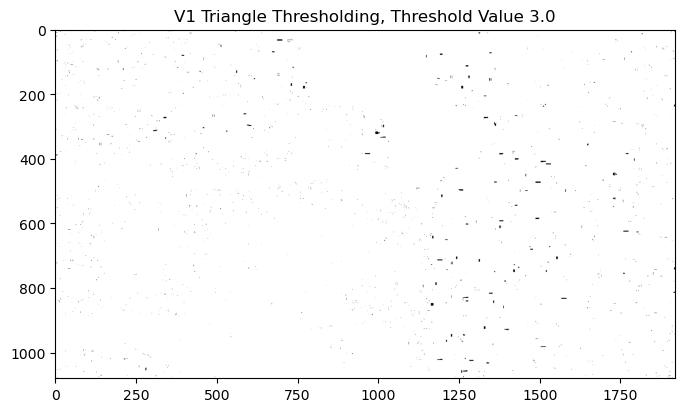

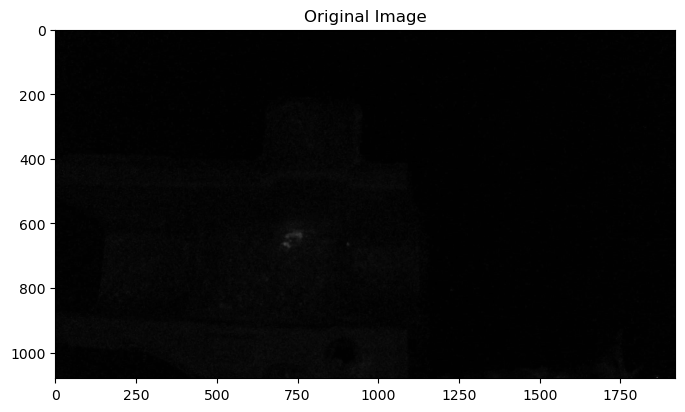

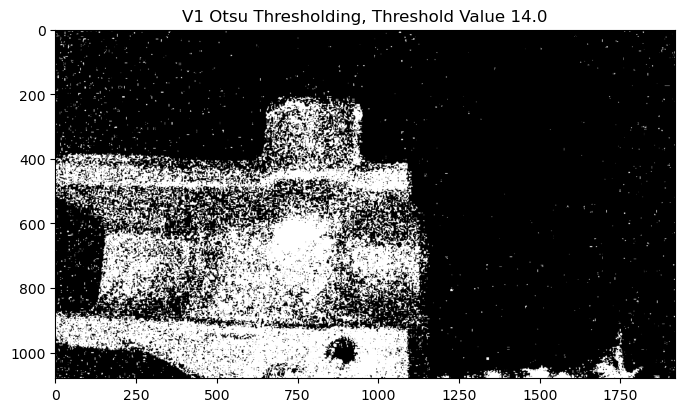

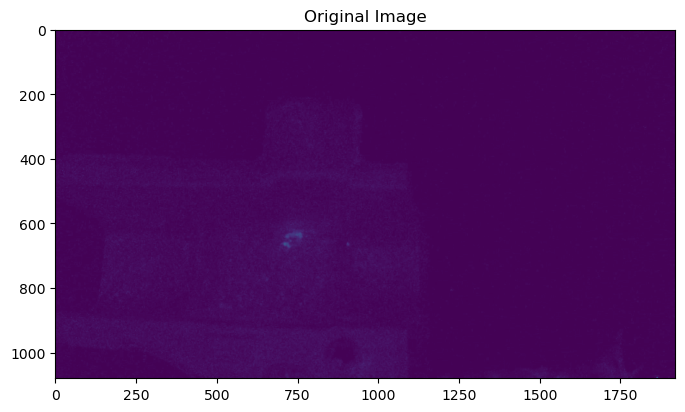

...

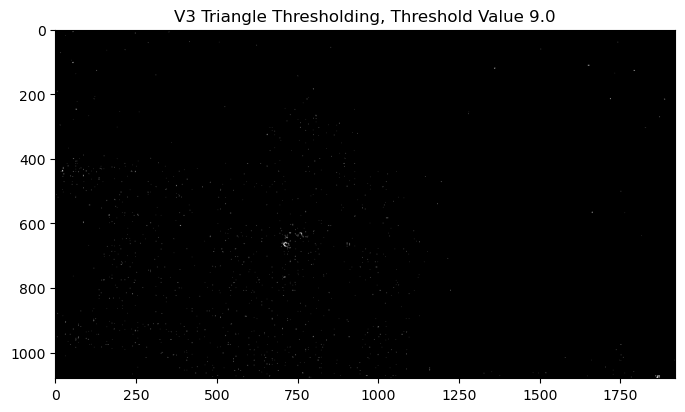

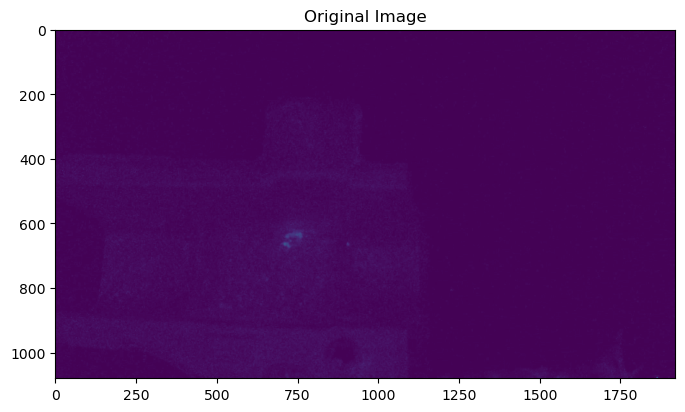

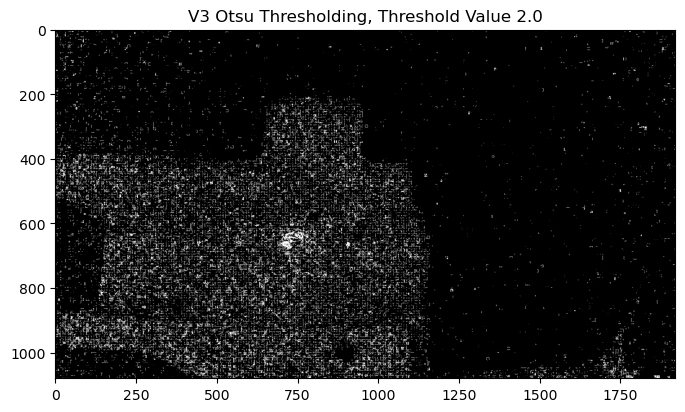

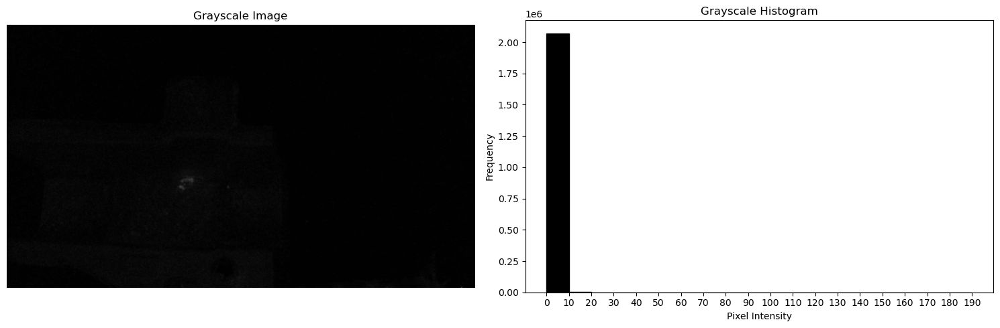

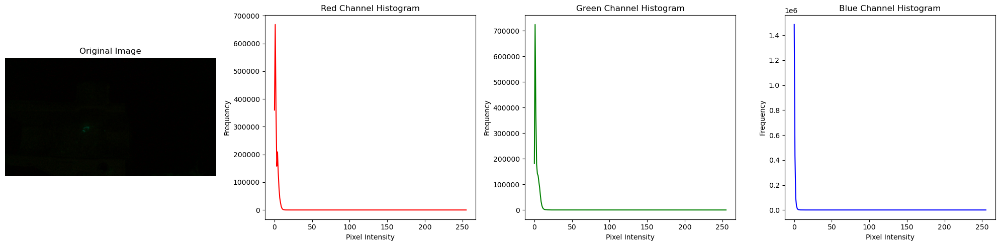

In [85]:
get_threshold_val_triangle_v1('Images/12-7-2024/Img24.jpg')
get_threshold_val_otsu_v1('Images/12-7-2024/Img24.jpg')
get_threshold_val_triangle_v2('Images/12-7-2024/Img24.jpg')
get_threshold_val_otsu_v2('Images/12-7-2024/Img24.jpg')
get_threshold_val_triangle_v3('Images/12-7-2024/Img24.jpg')
get_threshold_val_otsu_v3('Images/12-7-2024/Img24.jpg')
draw_hist_gray_img('Images/12-7-2024/Img24.jpg')
draw_hist_rgb_img('Images/12-7-2024/Img24.jpg')